In [1]:
import os
import re
import sys
if '/mnt/c/Users/attic/HLS Kelp Detection/tools' not in sys.path:
    sys.path.append('/mnt/c/Users/attic/HLS Kelp Detection/tools')
import kelp_tools_linux as kt
import time 
import rasterio
import cupy as cp
import cudf
import numpy as np
from rasterio.errors import RasterioIOError
import matplotlib.pyplot as plt
from cuml.ensemble import RandomForestClassifier as cuRF
from cuml.model_selection import train_test_split
from scipy.stats import randint
import pickle
import csv
from cupyx.scipy.ndimage import binary_dilation, convolve
from IPython.display import clear_output
from matplotlib.colors import ListedColormap
import filing_tools as ft
from pyproj import Transformer
from matplotlib import rcParams

In [2]:
reclassify = True #Reclassify previously classified images
show_image = True
sleep = False
#classified_path = r'/mnt/c/users/attic/hls_kelp/imagery/rf_classified_cuML'
save_final_data = False
version = 1

backup_frequency = 5
tile = '10UCU'
location = 'Isla_vista_kelp'
save_to_path = rf'/mnt/c/Users/attic/HLS Kelp Detection/processed imagery/tiles'
endmember_path = rf'/mnt/c/Users/attic/HLS_Kelp/python_objects/EM_Dict_v{version}.pkl'
cloud_cover_threshold = .5
save_EMs = False
use_constant_EM = False
only_pairs = False
#save_mask = True
#save_classification = True
#remask = False
path = os.path.join(f'/mnt/c/Users/attic/HLS Kelp Detection/imagery/tiles/{tile}')
#H:\HLS_data\imagery\Catalina\11SLT
dem_path = os.path.join(path,'dem')
rf_model = 'cu_rf10'
rf_path = os.path.join(r'/mnt/c/Users/attic/HLS Kelp Detection/random_forest',rf_model)
num_iterations = 2000

#unclassified_path = r'/mnt/c/users/attic/hls_kelp/imagery/rf_prepped_v2'
#unclassified_files = os.listdir(unclassified_path)

In [3]:
print(os.listdir(path))

['dem', 'HLS.L30.T10UCU.2017136T191314.v2.0', 'HLS.L30.T10UCU.2017145T190709.v2.0', 'HLS.L30.T10UCU.2017177T190722.v2.0', 'HLS.L30.T10UCU.2017184T191334.v2.0', 'HLS.L30.T10UCU.2017186T190113.v2.0', 'HLS.L30.T10UCU.2017216T191347.v2.0', 'HLS.L30.T10UCU.2017218T190126.v2.0', 'HLS.L30.T10UCU.2017225T190739.v2.0', 'HLS.L30.T10UCU.2017234T190130.v2.0', 'HLS.L30.T10UCU.2017257T190743.v2.0', 'HLS.L30.T10UCU.2017264T191357.v2.0', 'HLS.L30.T10UCU.2017266T190137.v2.0', 'HLS.L30.T10UCU.2017282T190142.v2.0', 'HLS.L30.T10UCU.2017305T190754.v2.0', 'HLS.L30.T10UCU.2017314T190142.v2.0', 'HLS.L30.T10UCU.2017337T190745.v2.0', 'HLS.L30.T10UCU.2018043T191337.v2.0', 'HLS.L30.T10UCU.2018045T190114.v2.0', 'HLS.L30.T10UCU.2018061T190131.v2.0', 'HLS.L30.T10UCU.2018068T190714.v2.0', 'HLS.L30.T10UCU.2018075T191320.v2.0', 'HLS.L30.T10UCU.2018091T191314.v2.0', 'HLS.L30.T10UCU.2018125T190033.v2.0', 'HLS.L30.T10UCU.2018196T190647.v2.0', 'HLS.L30.T10UCU.2018203T191300.v2.0', 'HLS.L30.T10UCU.2018205T190039.v2.0', 'HLS

In [4]:
def reduce_cudf_zero(df):
    arr = df.to_cupy()
    non_zero_mask = cp.any(arr != 0, axis=1)
    reduced_df = df[non_zero_mask]
    original_indices = cp.arange(arr.shape[0])
    filtered_indices = original_indices[non_zero_mask]
    return reduced_df, filtered_indices, original_indices 
def revert_cudf_zero(reduced_df, filtered_indices, original_indices):
    # Create a full-sized column initialized with zeros or NaNs
    # if reduced_df.ndim == 1:  # Handle 1D case (single column)
    full_df = cudf.Series(cp.full(len(original_indices), 3))
    # else:  # Handle 2D case (multiple columns)
    #     full_df = cudf.DataFrame(cp.full((len(original_indices), reduced_df.shape[1]), cp.nan))
    # Insert the reduced data into the appropriate positions
    full_df.iloc[filtered_indices] = reduced_df
    
    return full_df

Starting HLS.L30.T10UCU.2017136T191314.v2.0
HLS.L30.T10UCU.2017136T191314.v2.0 Percent cloud covered: 0.36894552786933366
Files Loaded. Duration:1.0859732627868652 seconds
bands normalized for RF. Duration:0.3810312747955322 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1672..2591].


RF finished. Duration:2.117650270462036 seconds


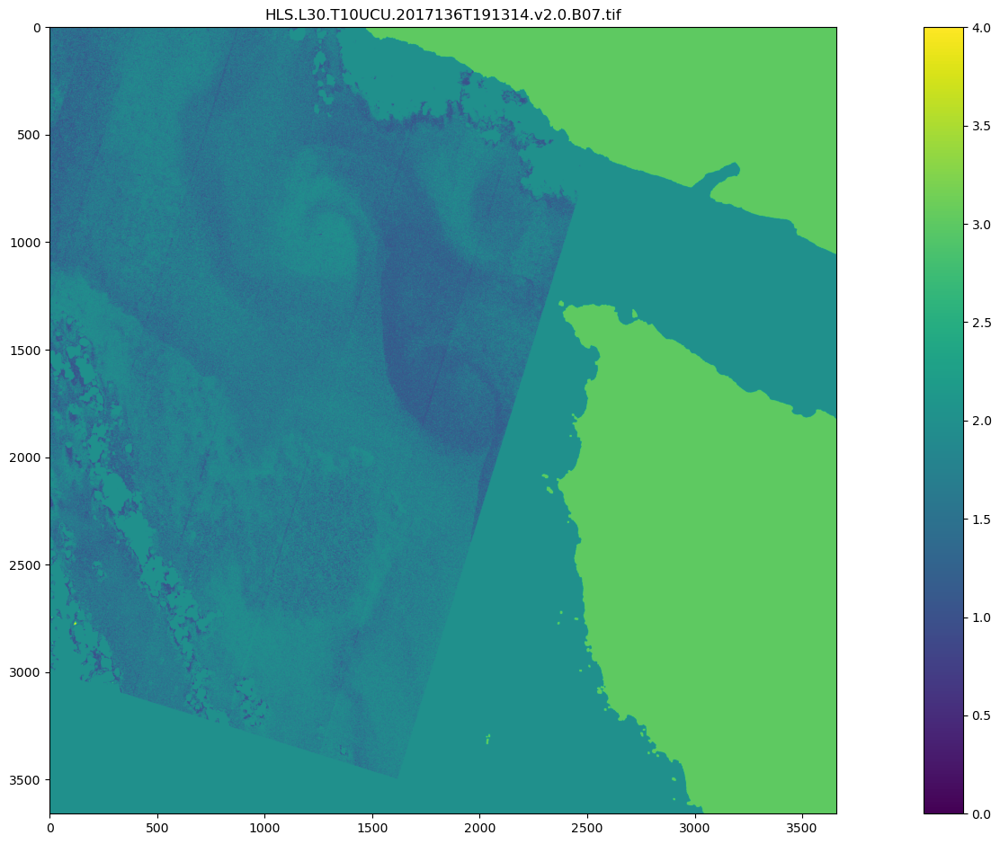

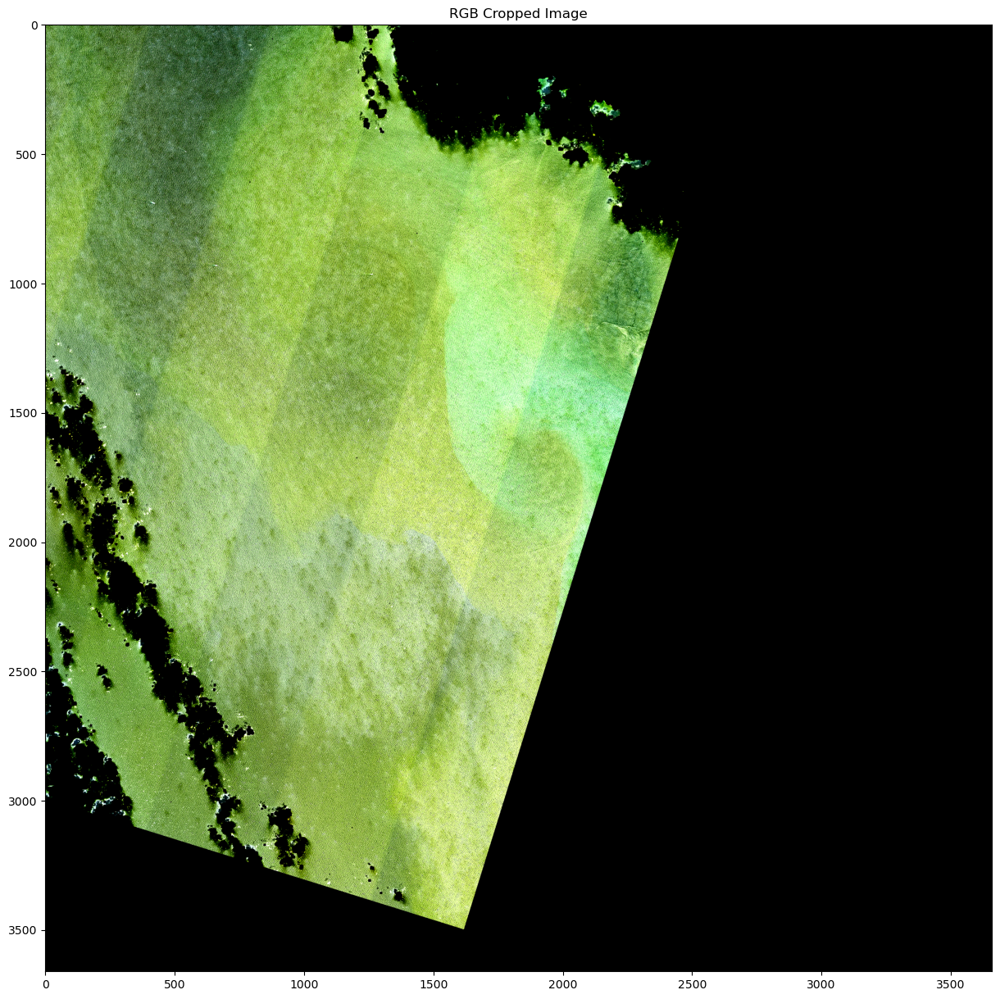

Masking finished. Duration:0.9859819412231445 seconds
MESMA finished. Duration:0.31918907165527344 seconds


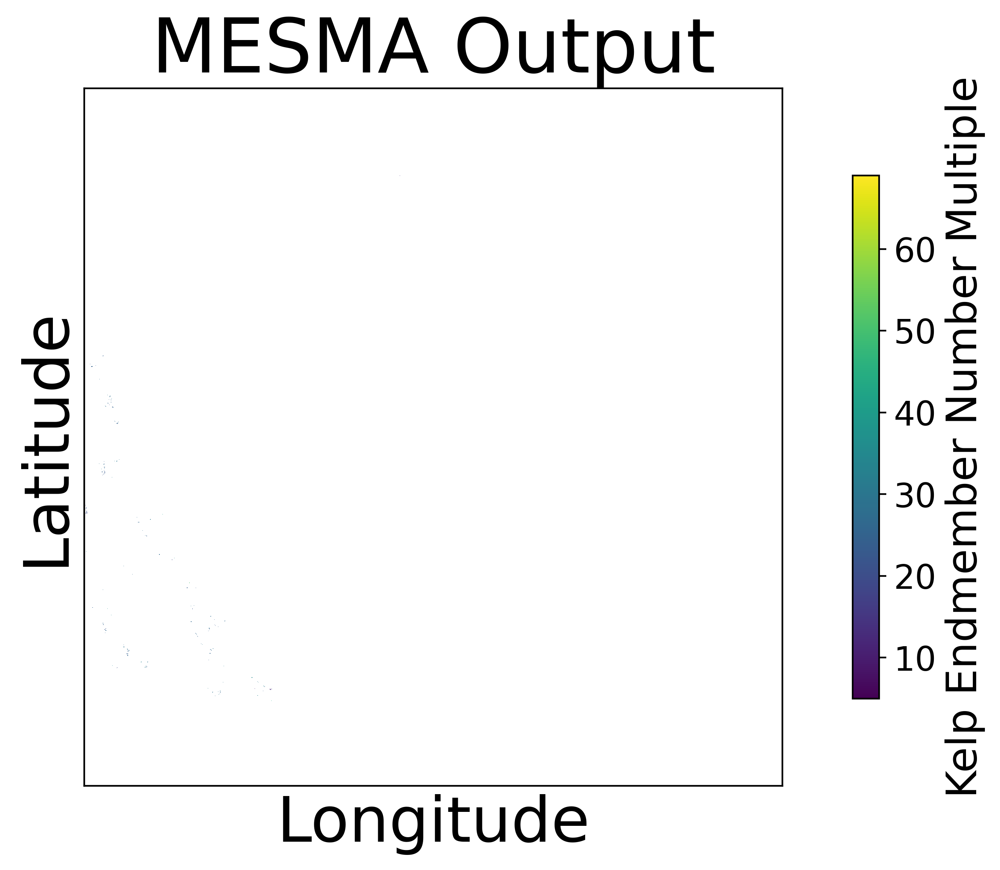

Processed Data Saved. Duration:3.814697265625e-06 seconds
File complete: HLS.L30.T10UCU.2017136T191314.v2.0 | Iteration: 1 | Time: 7.99202036857605
Starting HLS.L30.T10UCU.2017145T190709.v2.0
HLS.L30.T10UCU.2017145T190709.v2.0 Percent cloud covered: 0.1909843703353005
Files Loaded. Duration:2.2222301959991455 seconds
bands normalized for RF. Duration:0.4023854732513428 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1578..5854].


RF finished. Duration:3.485208511352539 seconds


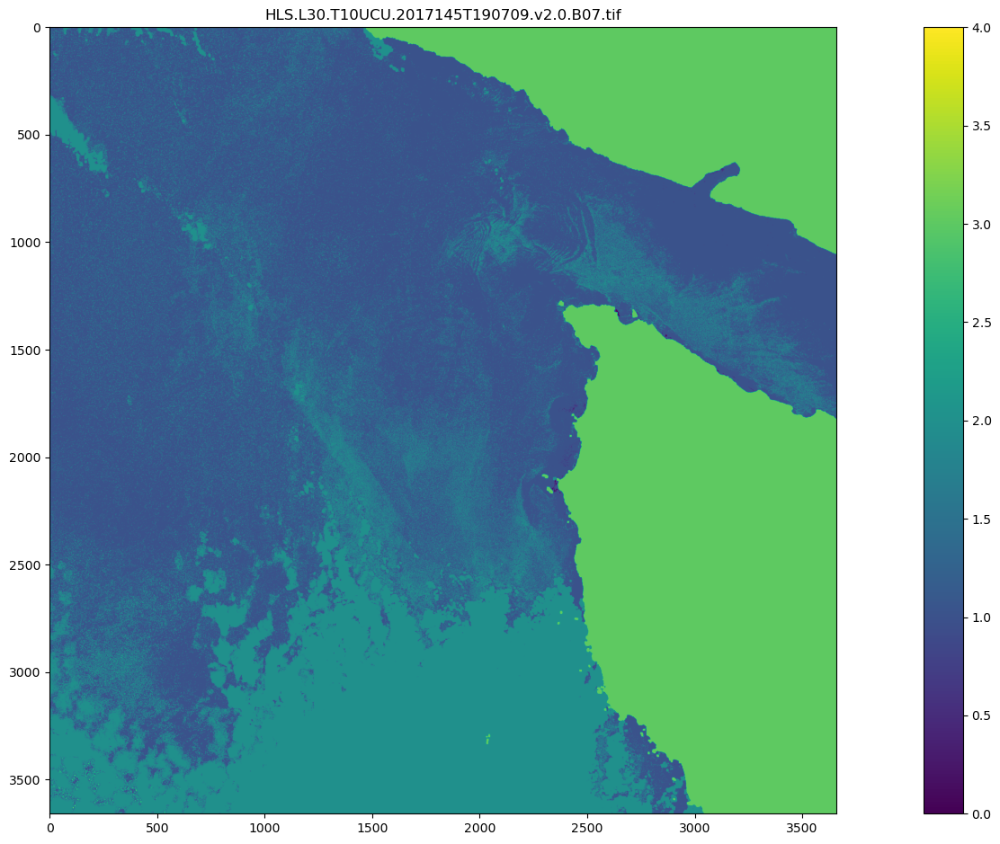

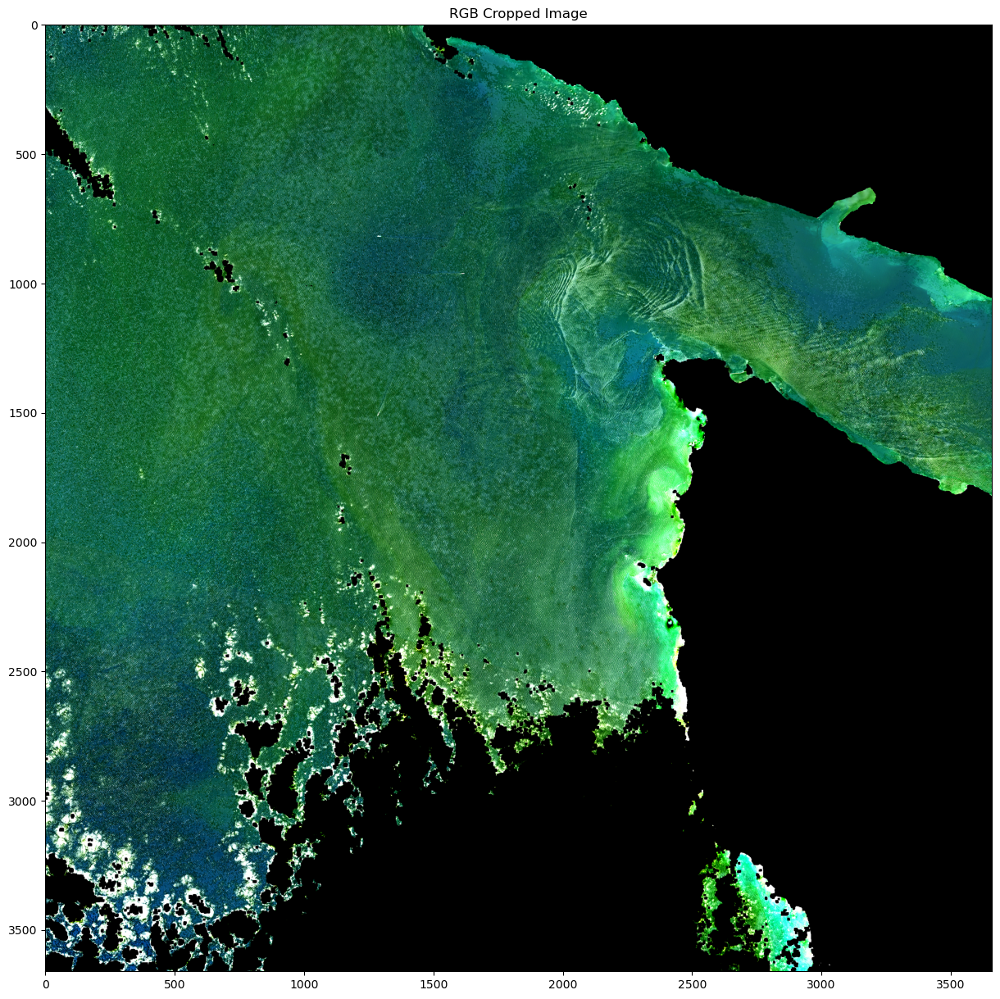

Masking finished. Duration:0.5696399211883545 seconds
MESMA finished. Duration:0.15716052055358887 seconds


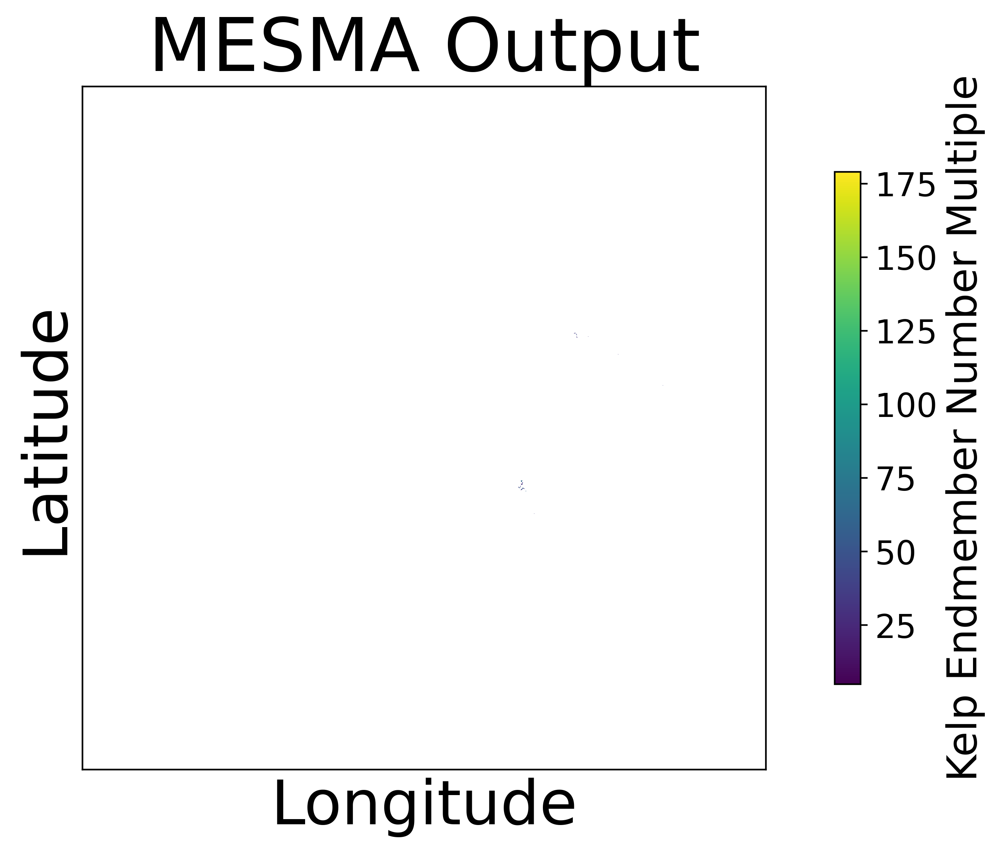

Processed Data Saved. Duration:0.000293731689453125 seconds
File complete: HLS.L30.T10UCU.2017145T190709.v2.0 | Iteration: 2 | Time: 10.109020948410034
Starting HLS.L30.T10UCU.2017177T190722.v2.0
HLS.L30.T10UCU.2017177T190722.v2.0 Percent cloud covered: 0.40862511421446085
Error reading file HLS.L30.T10UCU.2017177T190722.v2.0.B03.tif in granule HLS.L30.T10UCU.2017177T190722.v2.0: Read or write failed. /mnt/c/Users/attic/HLS Kelp Detection/imagery/tiles/10UCU/HLS.L30.T10UCU.2017177T190722.v2.0/HLS.L30.T10UCU.2017177T190722.v2.0.B03.tif, band 1: IReadBlock failed at X offset 0, Y offset 0: TIFFReadEncodedTile() failed.
Starting HLS.L30.T10UCU.2017184T191334.v2.0
HLS.L30.T10UCU.2017184T191334.v2.0 Percent cloud covered: 0.34732926634359934
Files Loaded. Duration:1.4777905941009521 seconds
bands normalized for RF. Duration:0.30032896995544434 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1240..3395].


RF finished. Duration:2.0621607303619385 seconds


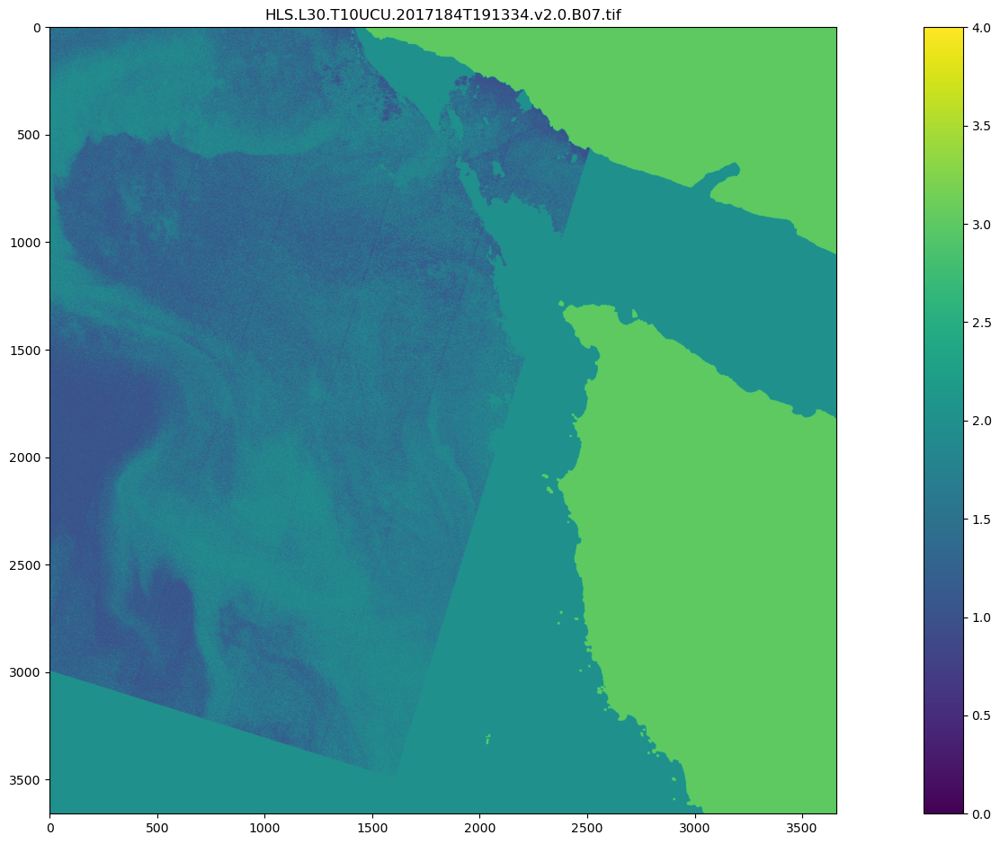

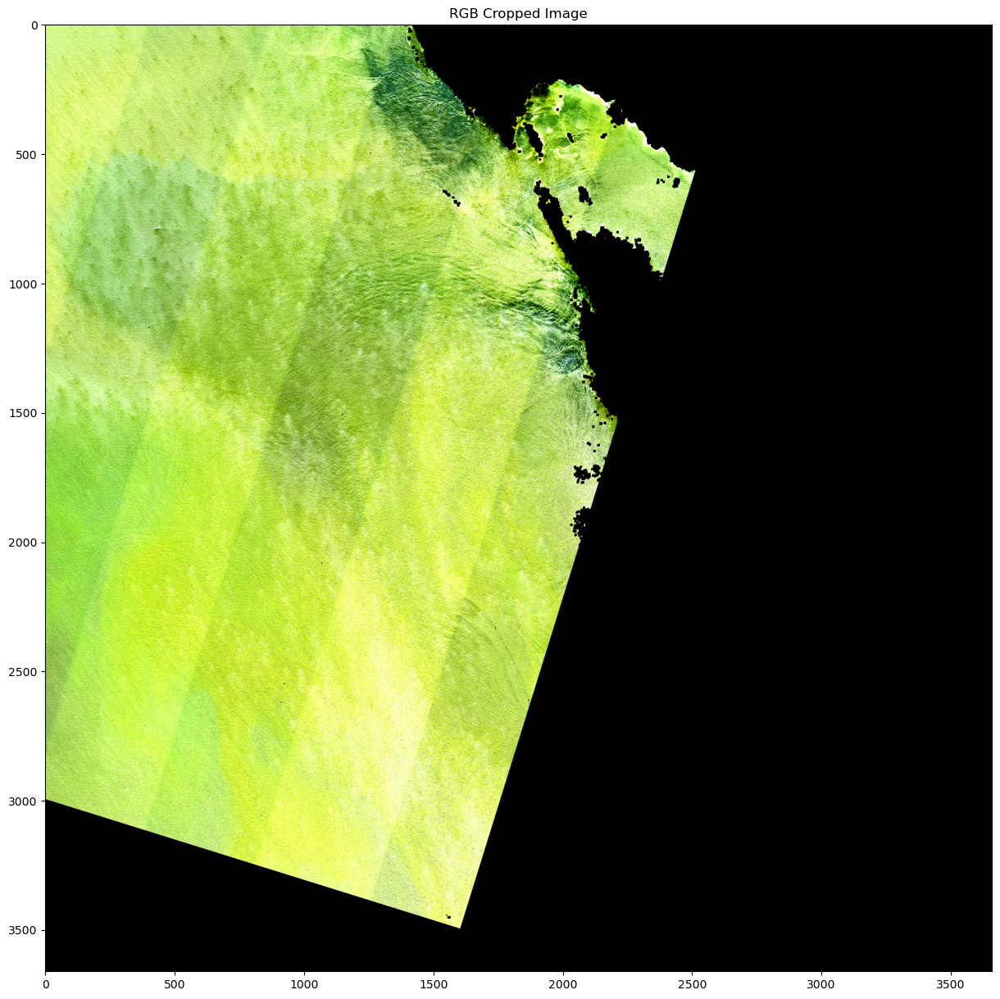

Masking finished. Duration:0.6550664901733398 seconds
MESMA finished. Duration:0.1495969295501709 seconds


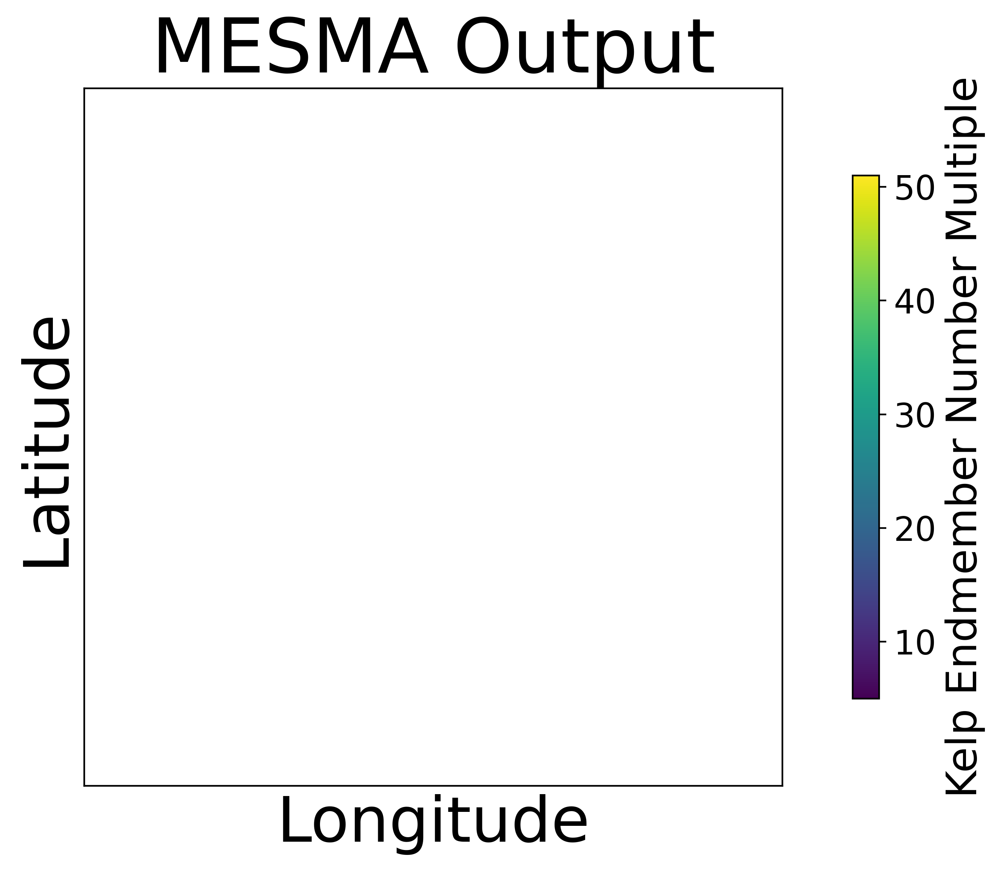

Processed Data Saved. Duration:0.00040221214294433594 seconds
File complete: HLS.L30.T10UCU.2017184T191334.v2.0 | Iteration: 3 | Time: 7.75564432144165
Starting HLS.L30.T10UCU.2017186T190113.v2.0
Starting HLS.L30.T10UCU.2017216T191347.v2.0
Starting HLS.L30.T10UCU.2017218T190126.v2.0
Starting HLS.L30.T10UCU.2017225T190739.v2.0
HLS.L30.T10UCU.2017225T190739.v2.0 Percent cloud covered: 0.12129882322667286
Files Loaded. Duration:2.2422611713409424 seconds
bands normalized for RF. Duration:0.3986368179321289 seconds
RF finished. Duration:3.258408308029175 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1235..3121].


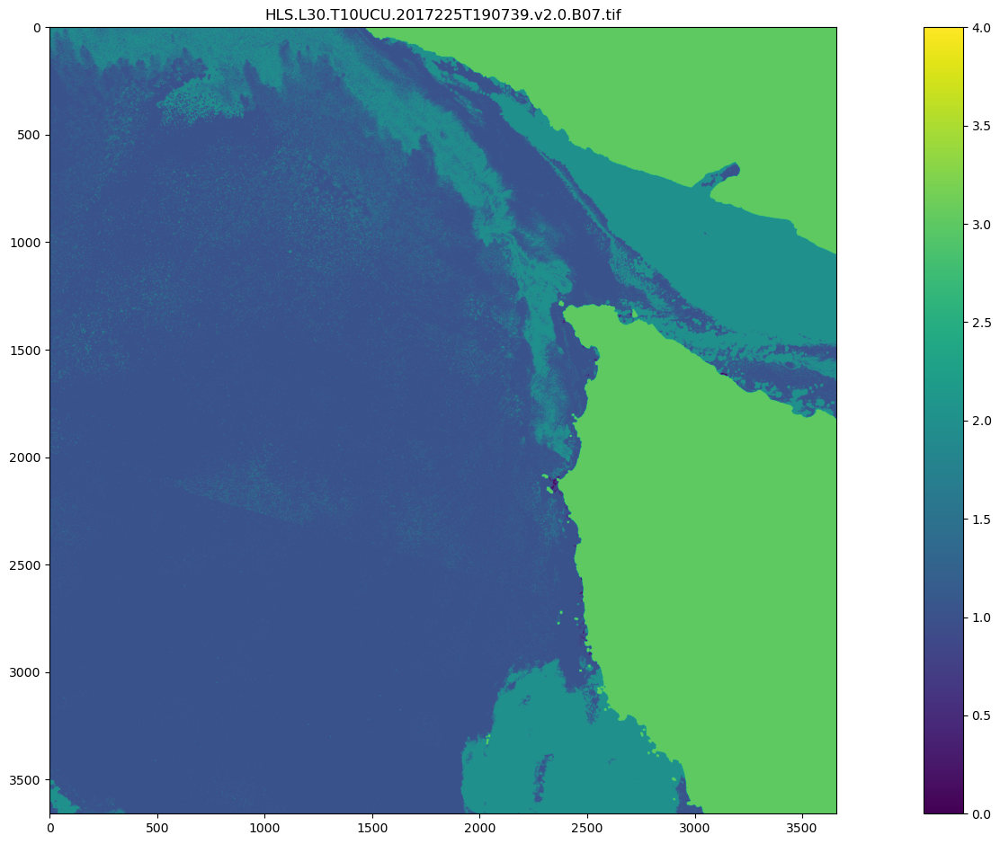

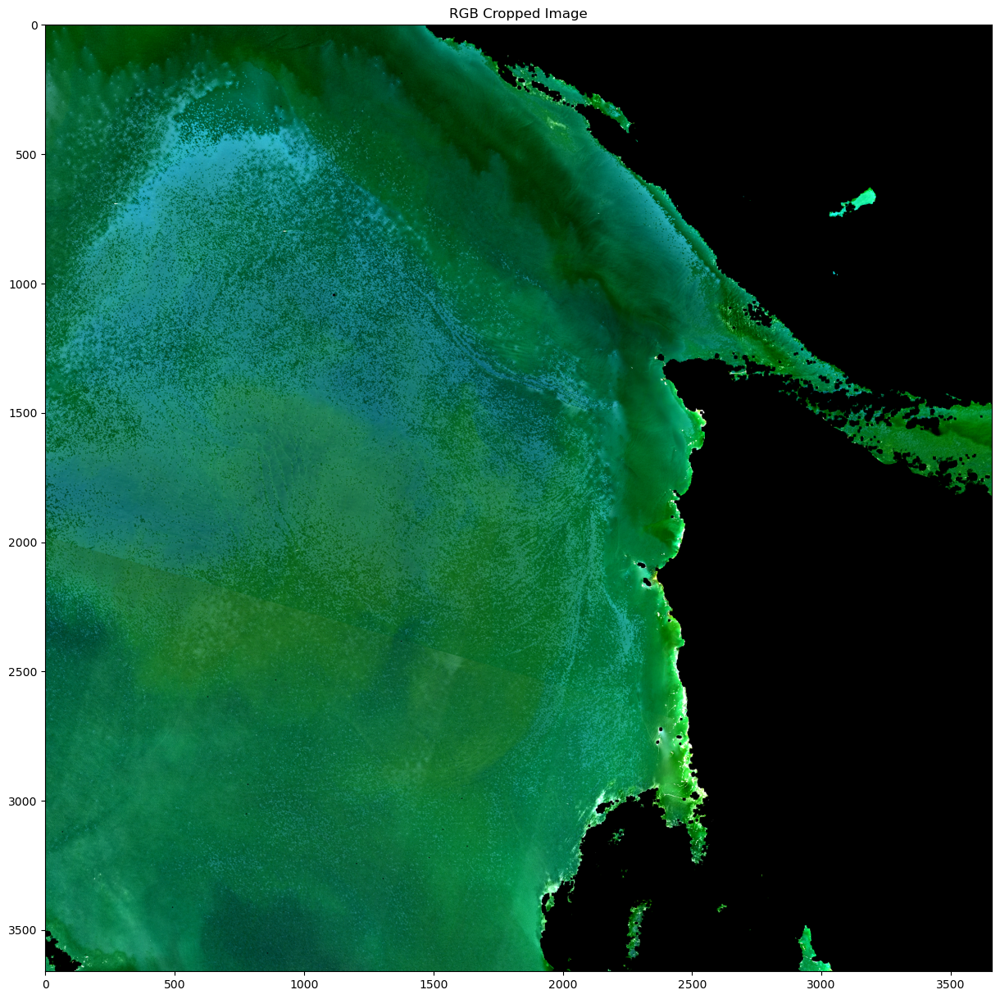

Masking finished. Duration:0.7888820171356201 seconds
MESMA finished. Duration:0.18359708786010742 seconds


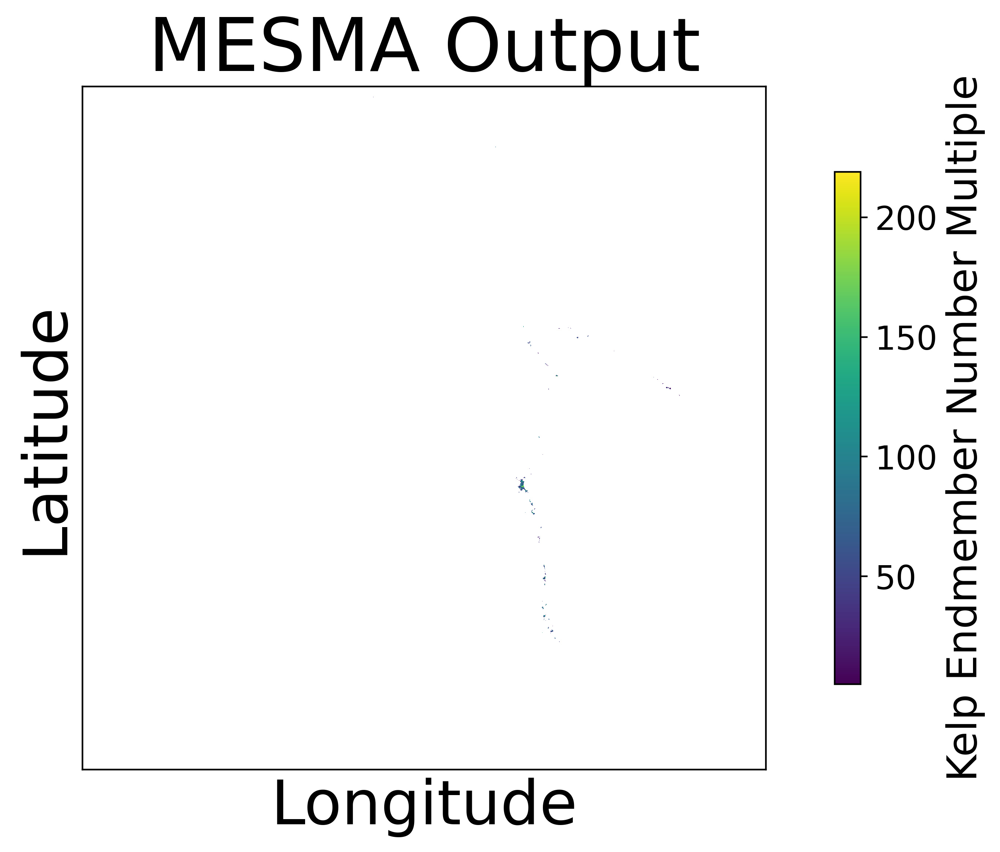

Processed Data Saved. Duration:0.0002987384796142578 seconds
File complete: HLS.L30.T10UCU.2017225T190739.v2.0 | Iteration: 4 | Time: 10.699577569961548
Starting HLS.L30.T10UCU.2017234T190130.v2.0
Starting HLS.L30.T10UCU.2017257T190743.v2.0
HLS.L30.T10UCU.2017257T190743.v2.0 Percent cloud covered: 5.397858346928498e-05
Files Loaded. Duration:2.6275503635406494 seconds
bands normalized for RF. Duration:0.27985262870788574 seconds
RF finished. Duration:3.2401037216186523 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-310..3152].


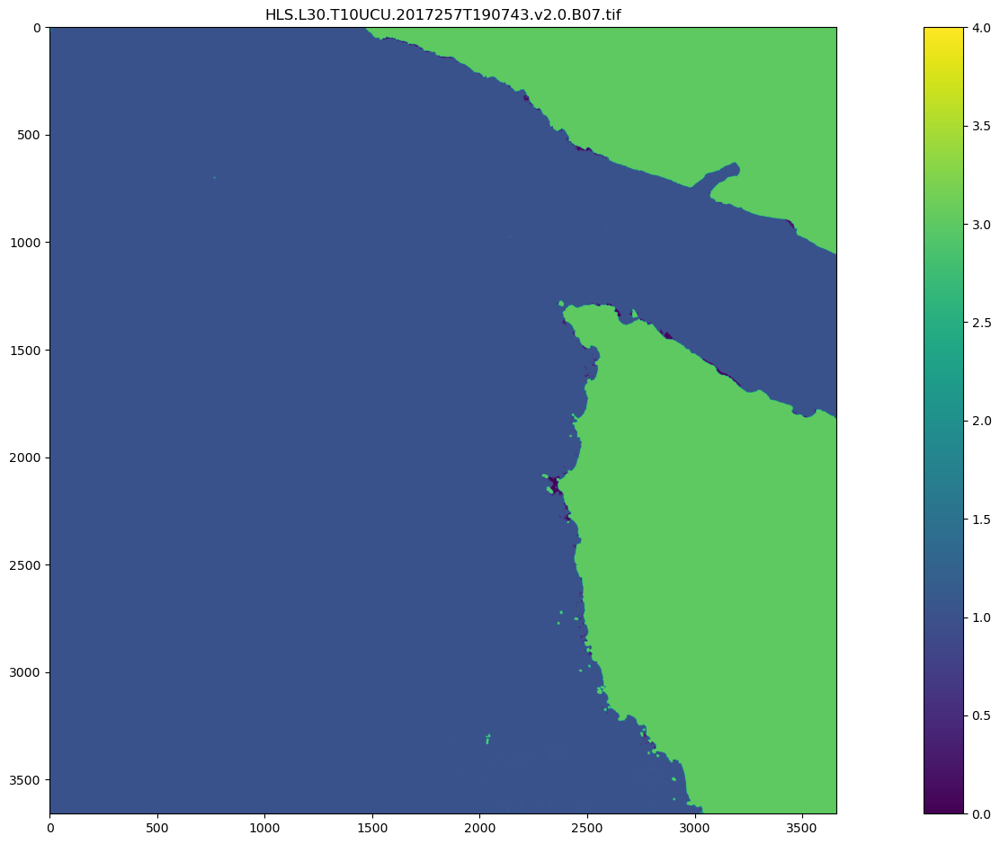

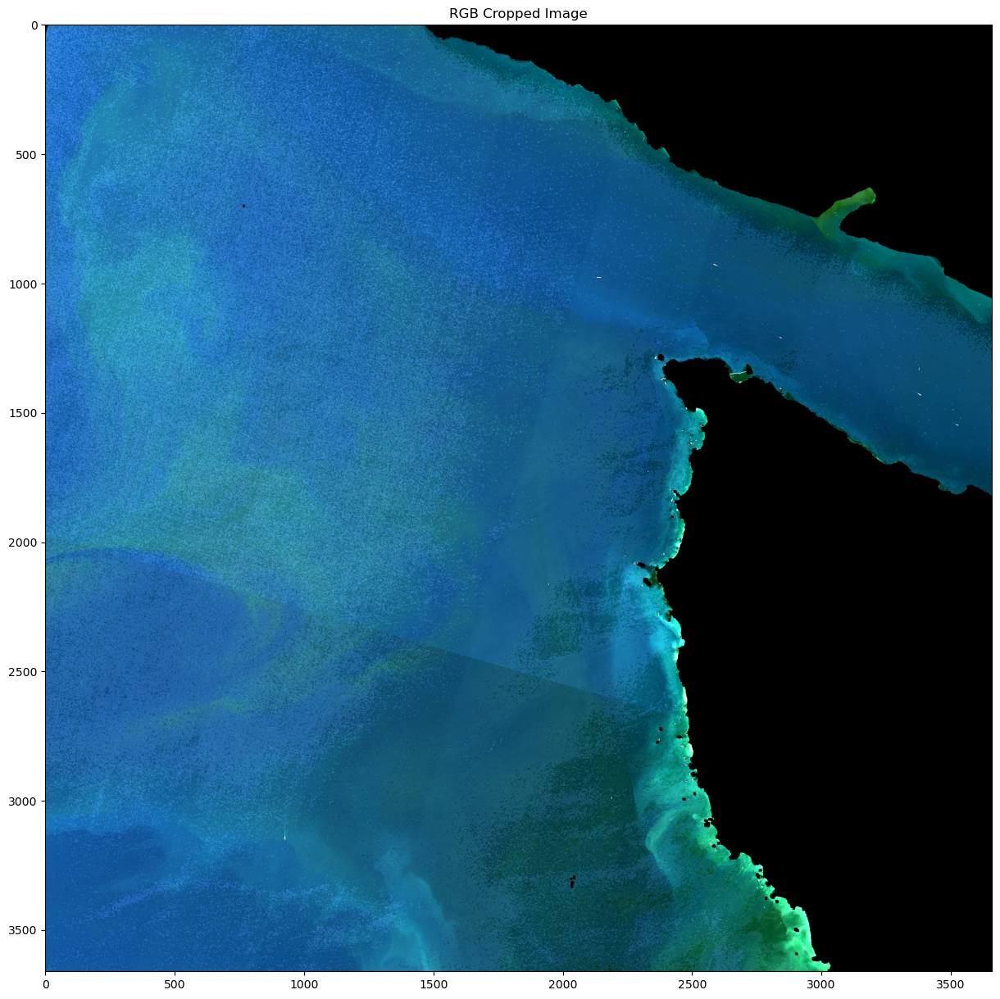

Masking finished. Duration:0.8149592876434326 seconds
MESMA finished. Duration:0.3021371364593506 seconds


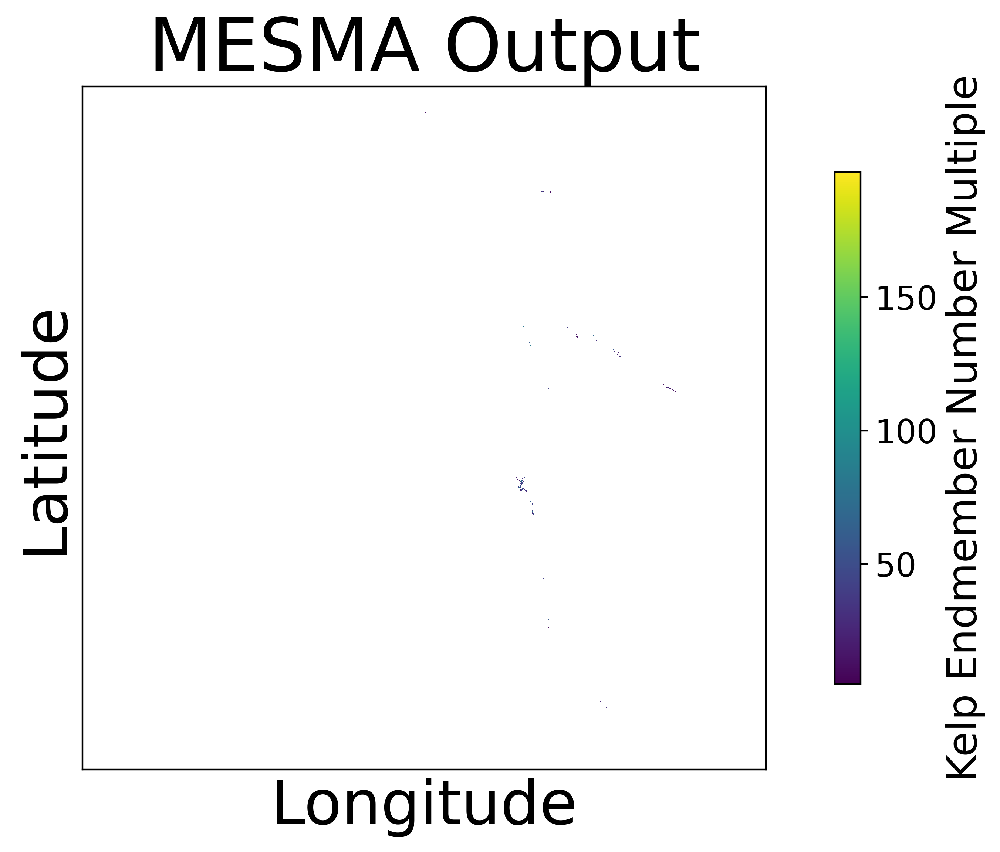

Processed Data Saved. Duration:0.0003266334533691406 seconds
File complete: HLS.L30.T10UCU.2017257T190743.v2.0 | Iteration: 5 | Time: 11.616187810897827
Starting HLS.L30.T10UCU.2017264T191357.v2.0
HLS.L30.T10UCU.2017264T191357.v2.0 Percent cloud covered: 0.3202386516813273
Files Loaded. Duration:1.6129543781280518 seconds
bands normalized for RF. Duration:0.290233850479126 seconds
RF finished. Duration:2.618882179260254 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1104..5445].


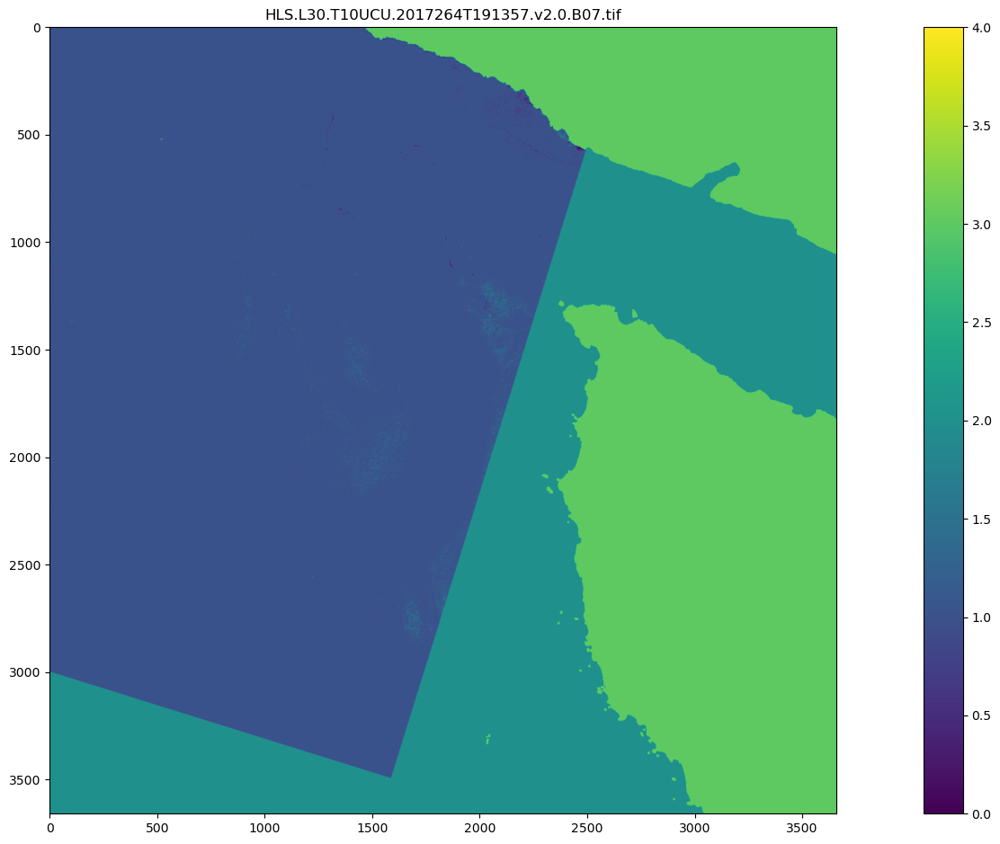

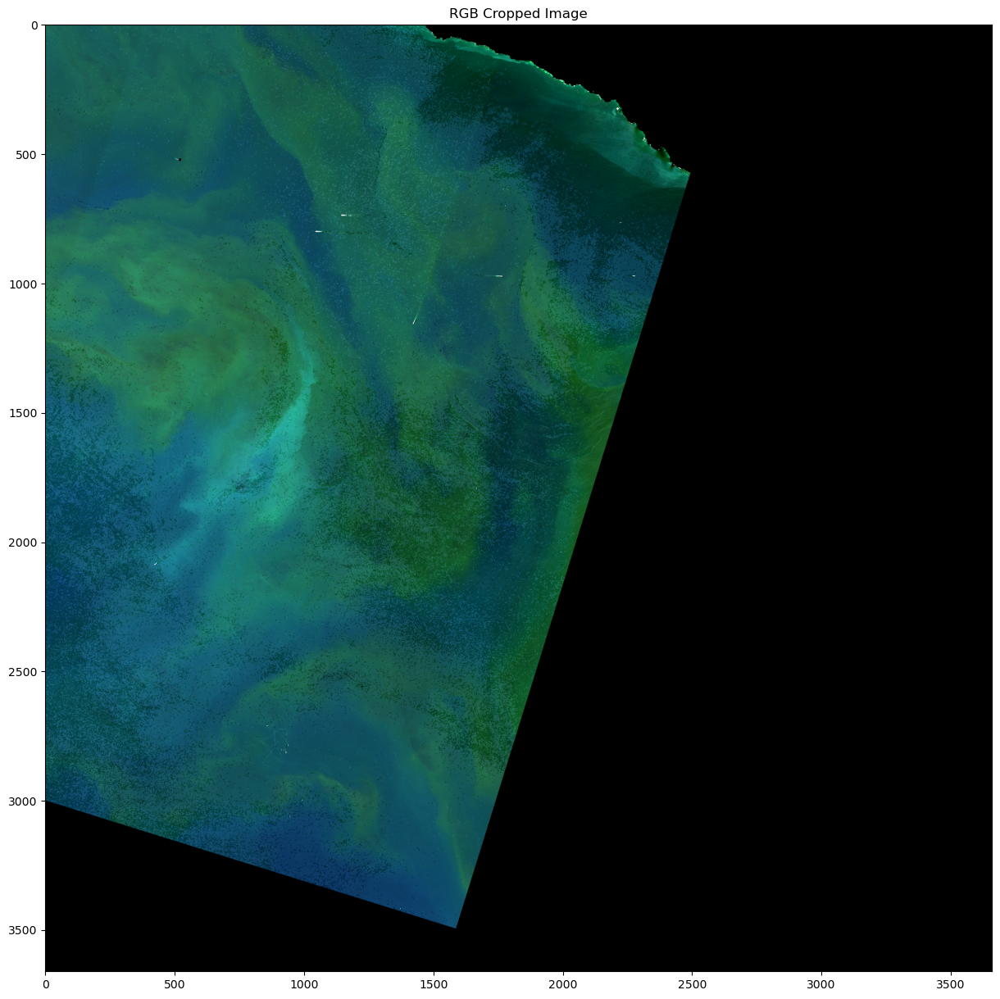

Masking finished. Duration:0.7650763988494873 seconds
MESMA finished. Duration:0.19576597213745117 seconds


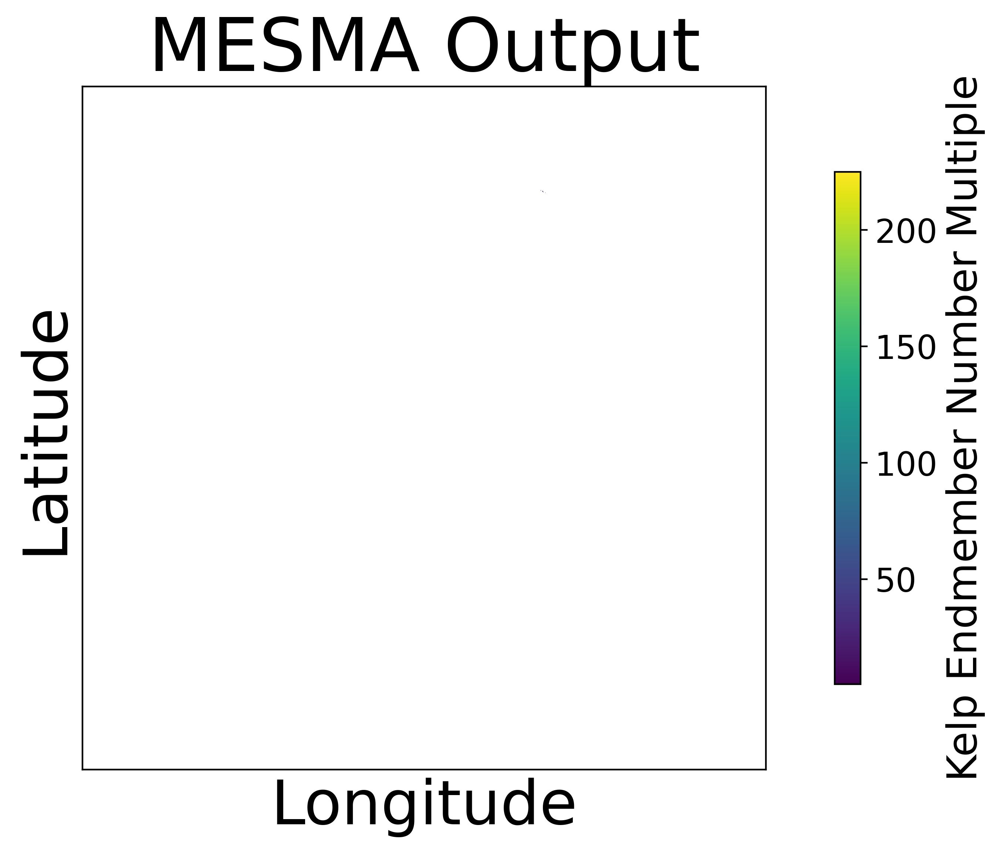

Processed Data Saved. Duration:0.00034046173095703125 seconds
File complete: HLS.L30.T10UCU.2017264T191357.v2.0 | Iteration: 6 | Time: 9.503472566604614
Starting HLS.L30.T10UCU.2017266T190137.v2.0
Starting HLS.L30.T10UCU.2017282T190142.v2.0
Starting HLS.L30.T10UCU.2017305T190754.v2.0
HLS.L30.T10UCU.2017305T190754.v2.0 Percent cloud covered: 0.2140069900757811
Files Loaded. Duration:2.552189588546753 seconds
bands normalized for RF. Duration:0.3728468418121338 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1814..6795].


RF finished. Duration:3.09702205657959 seconds


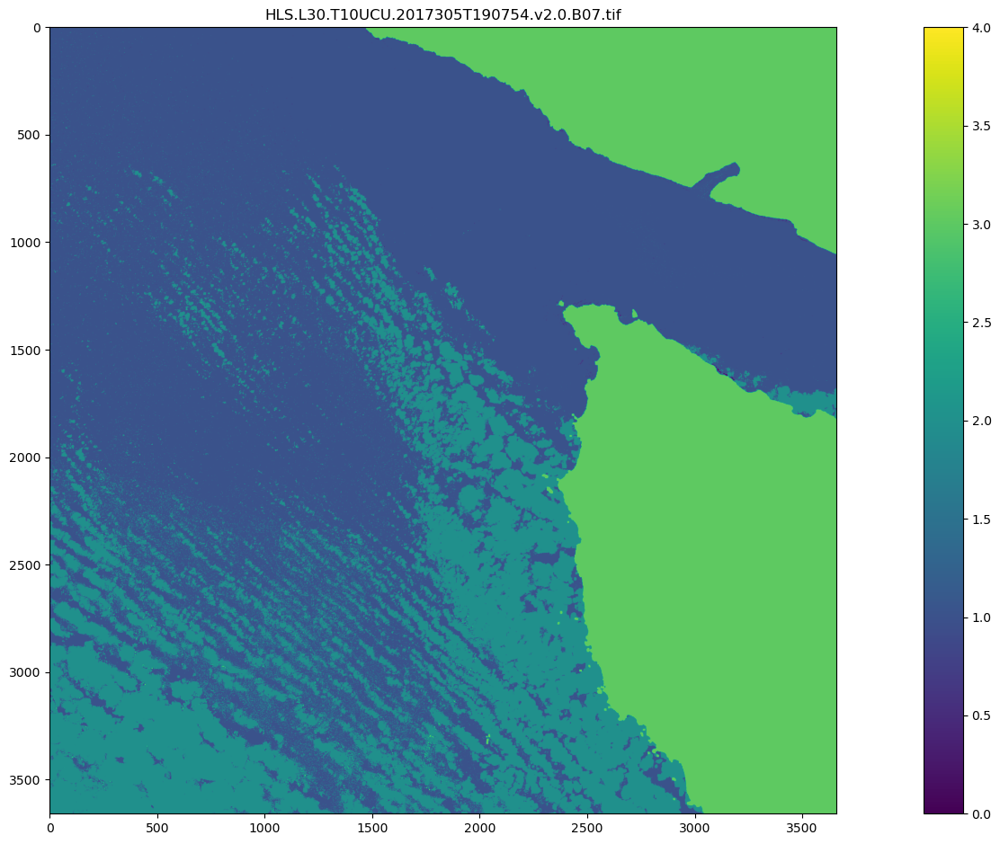

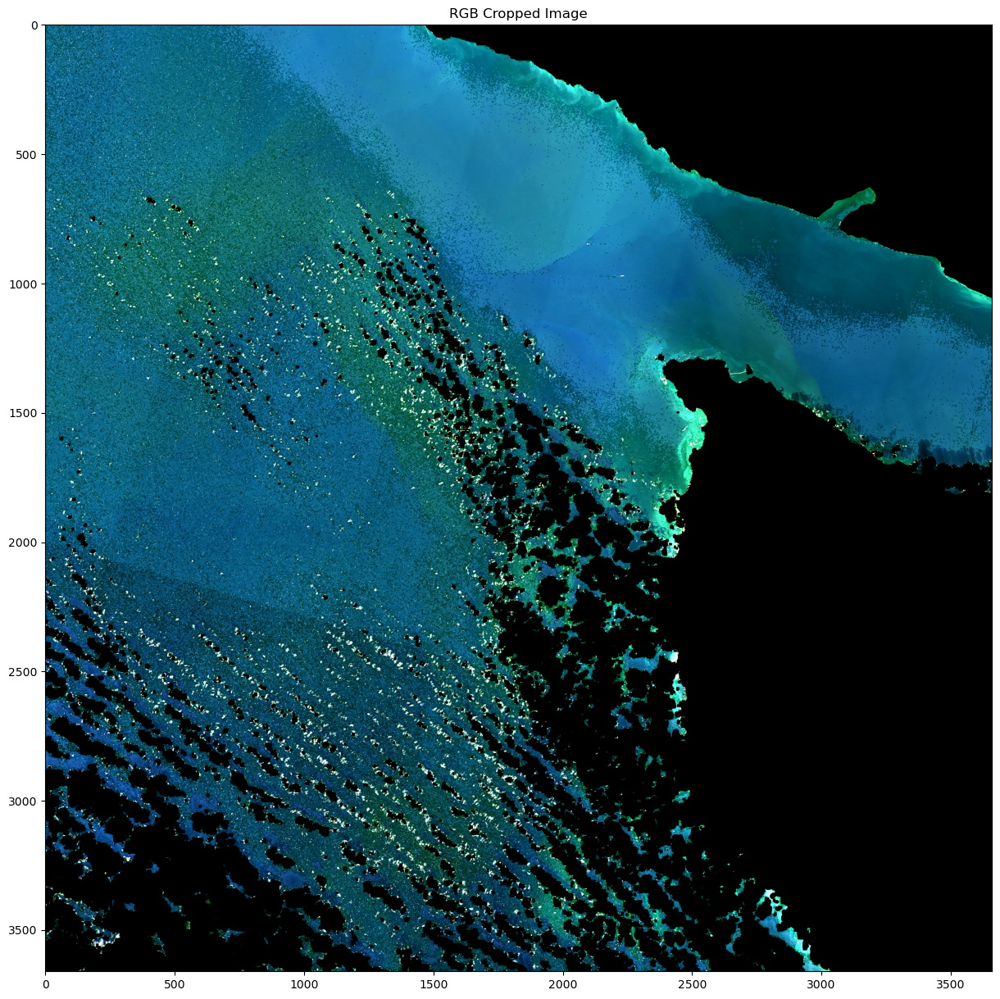

Masking finished. Duration:0.8089048862457275 seconds
MESMA finished. Duration:0.18669819831848145 seconds


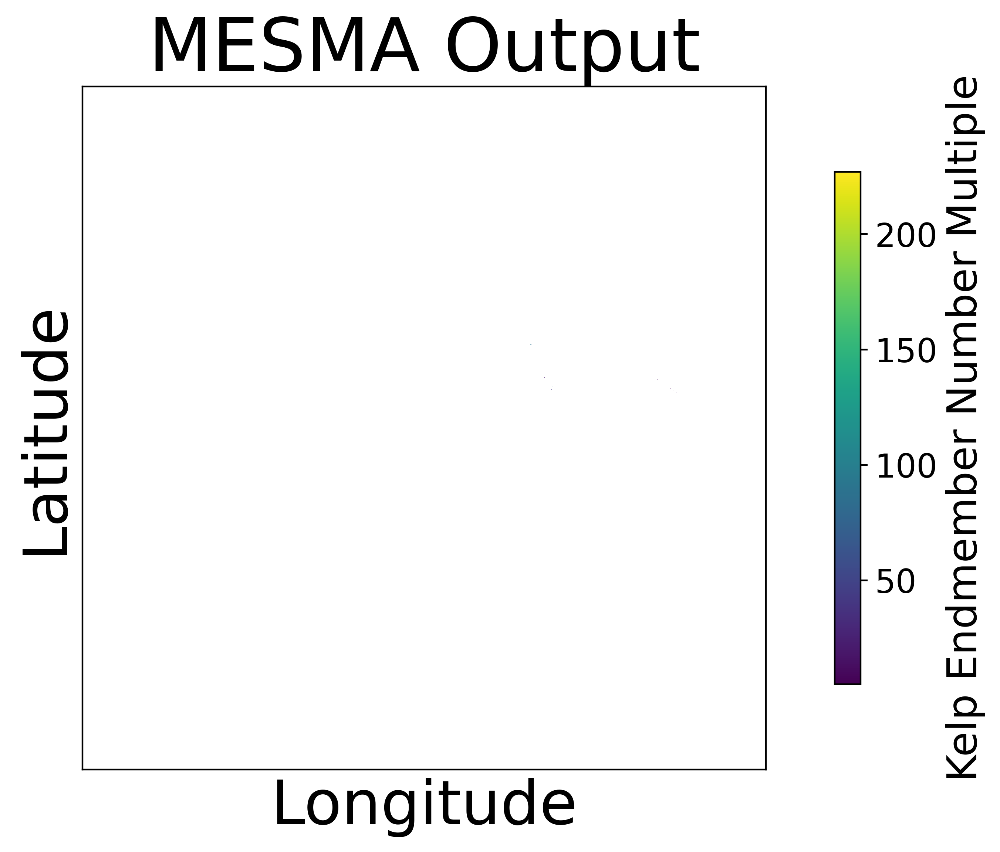

Processed Data Saved. Duration:0.0003924369812011719 seconds
File complete: HLS.L30.T10UCU.2017305T190754.v2.0 | Iteration: 7 | Time: 11.162212133407593
Starting HLS.L30.T10UCU.2017314T190142.v2.0
Starting HLS.L30.T10UCU.2017337T190745.v2.0
HLS.L30.T10UCU.2017337T190745.v2.0 Percent cloud covered: 0.0595134489098236
Files Loaded. Duration:2.6423587799072266 seconds
bands normalized for RF. Duration:0.2947866916656494 seconds
RF finished. Duration:3.075622797012329 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2343..10926].


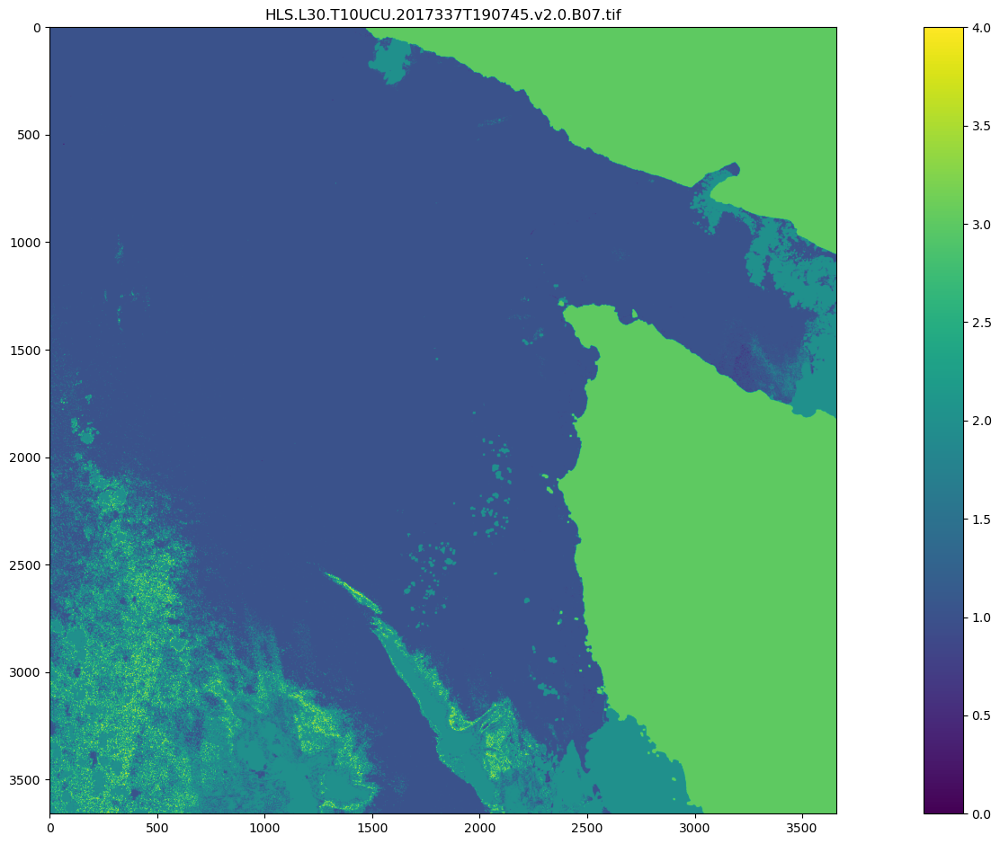

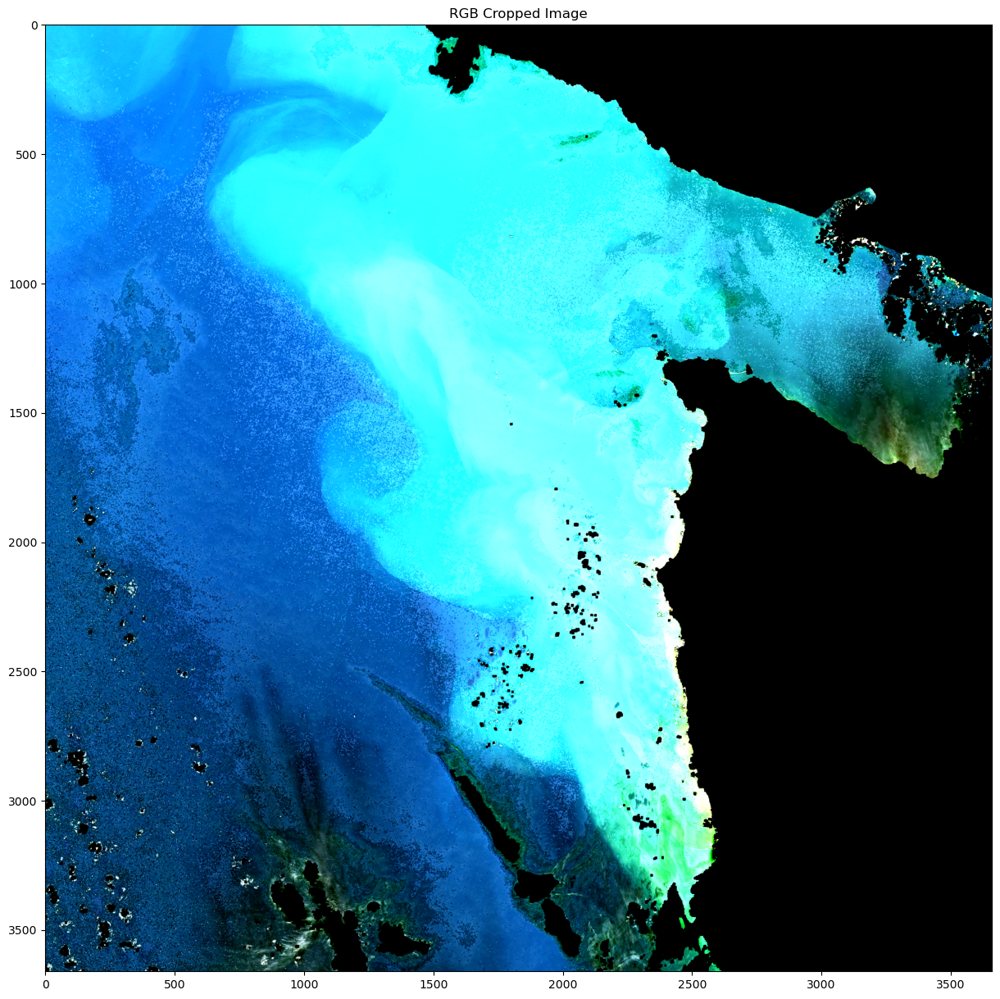

Masking finished. Duration:0.7974255084991455 seconds
MESMA finished. Duration:0.19874358177185059 seconds


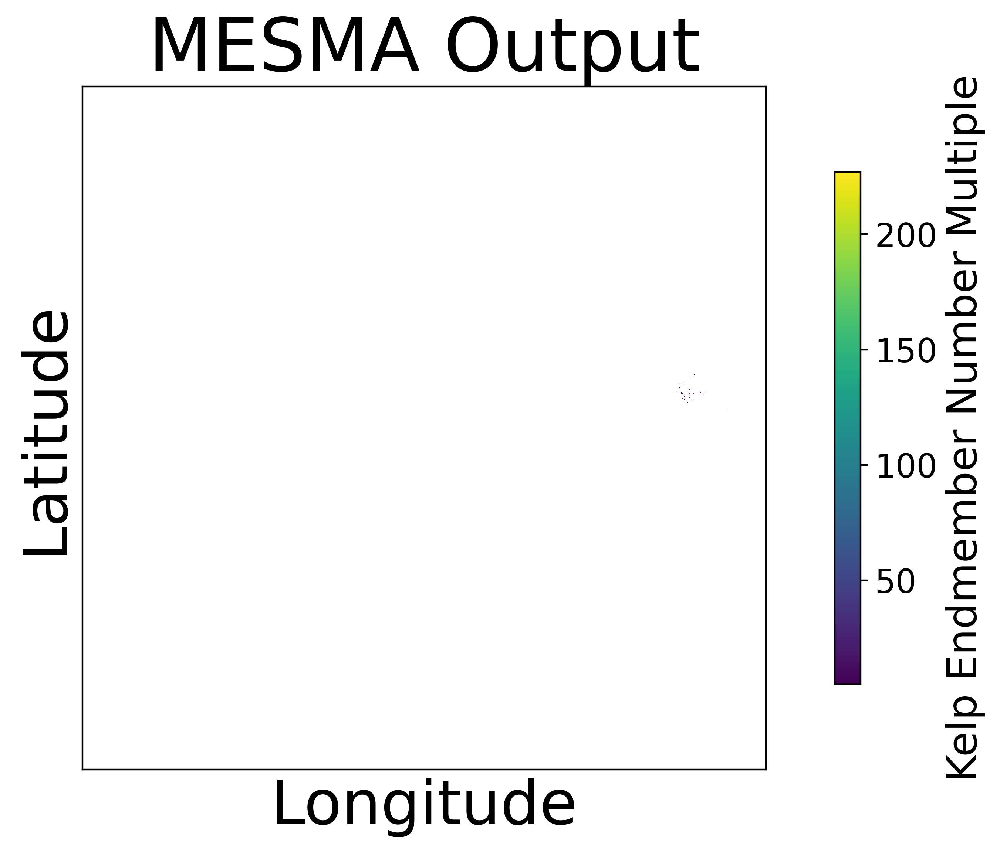

Processed Data Saved. Duration:0.00036787986755371094 seconds
File complete: HLS.L30.T10UCU.2017337T190745.v2.0 | Iteration: 8 | Time: 11.242154121398926
Starting HLS.L30.T10UCU.2018043T191337.v2.0
HLS.L30.T10UCU.2018043T191337.v2.0 Percent cloud covered: 0.3247670226036575
Files Loaded. Duration:1.8752129077911377 seconds
bands normalized for RF. Duration:0.26495885848999023 seconds
RF finished. Duration:2.953977584838867 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1617..3934].


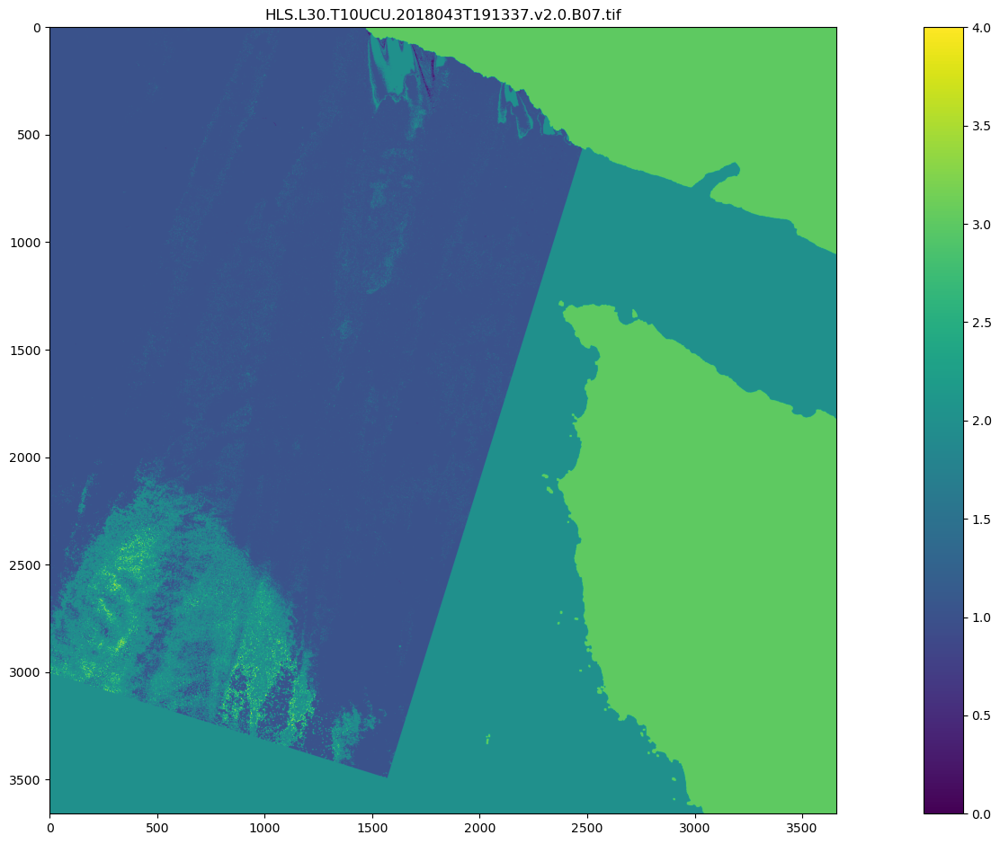

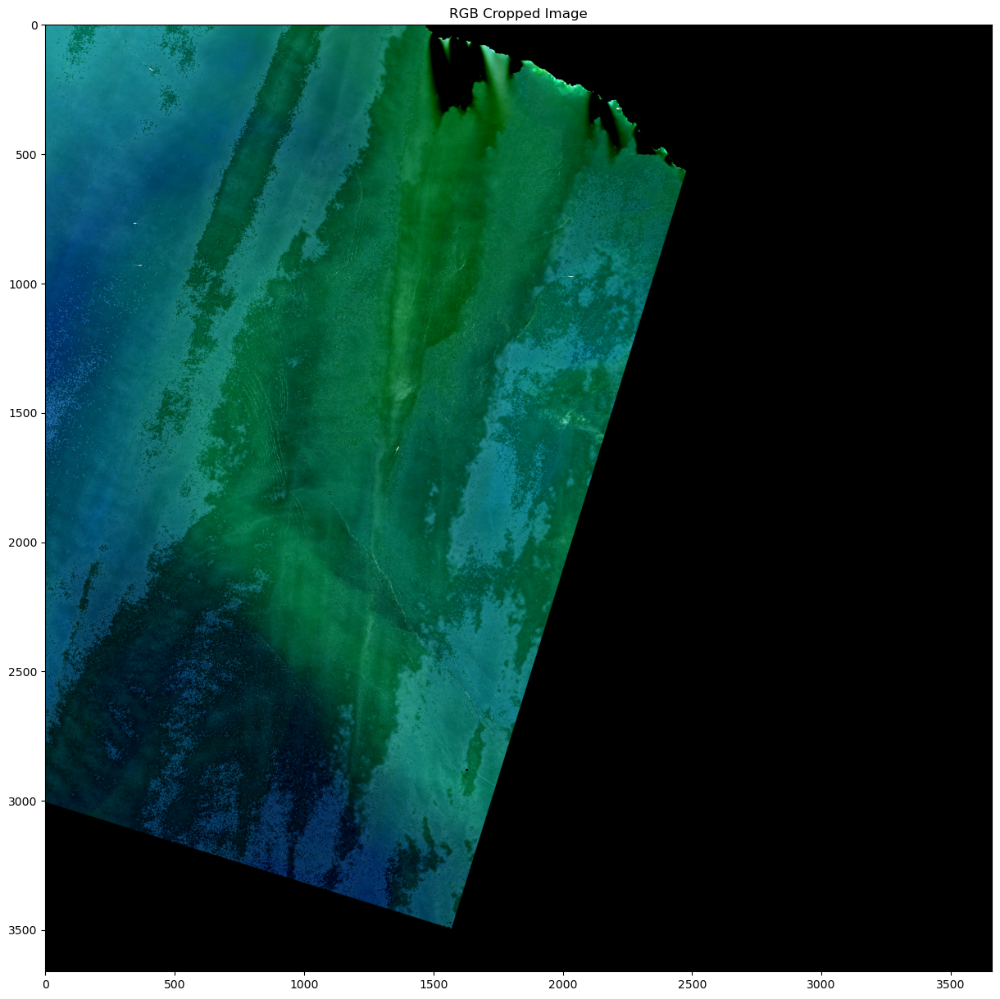

Masking finished. Duration:0.7779371738433838 seconds
MESMA finished. Duration:0.15787768363952637 seconds


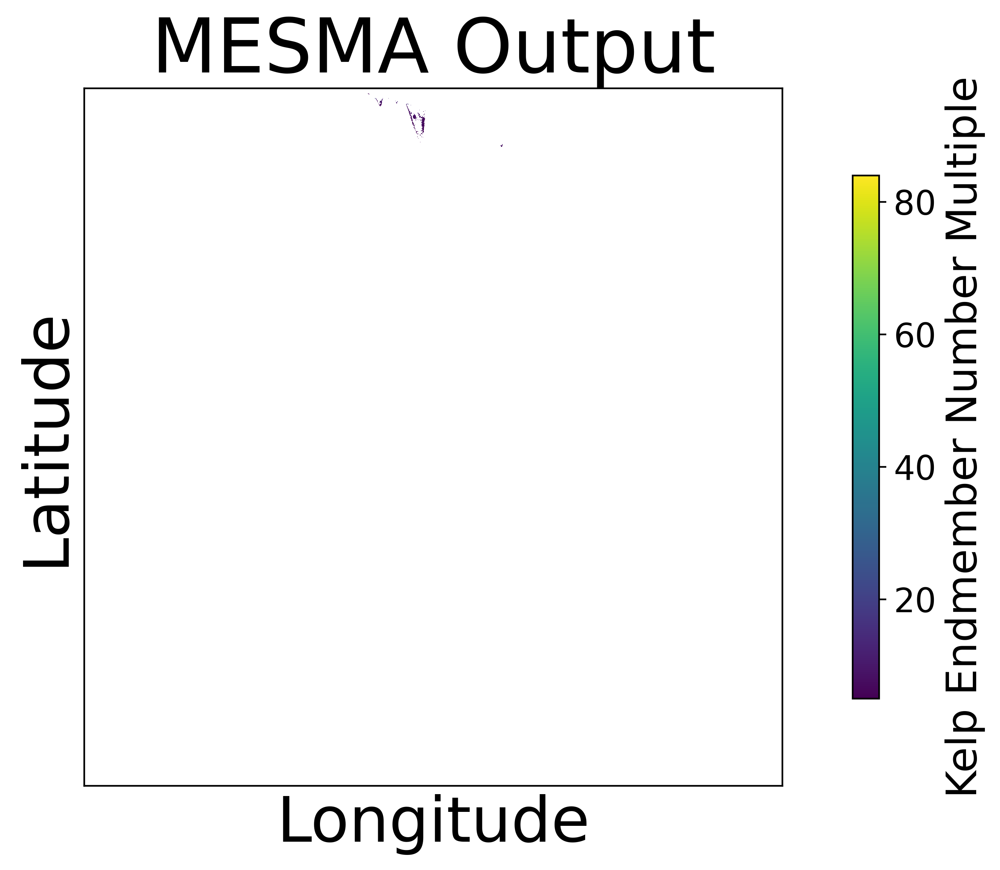

Processed Data Saved. Duration:0.0005931854248046875 seconds
File complete: HLS.L30.T10UCU.2018043T191337.v2.0 | Iteration: 9 | Time: 10.279313325881958
Starting HLS.L30.T10UCU.2018045T190114.v2.0
Starting HLS.L30.T10UCU.2018061T190131.v2.0
Starting HLS.L30.T10UCU.2018068T190714.v2.0
HLS.L30.T10UCU.2018068T190714.v2.0 Percent cloud covered: 0.19859223452236996
Files Loaded. Duration:2.8034608364105225 seconds
bands normalized for RF. Duration:0.3902449607849121 seconds
RF finished. Duration:3.0461232662200928 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1880..6693].


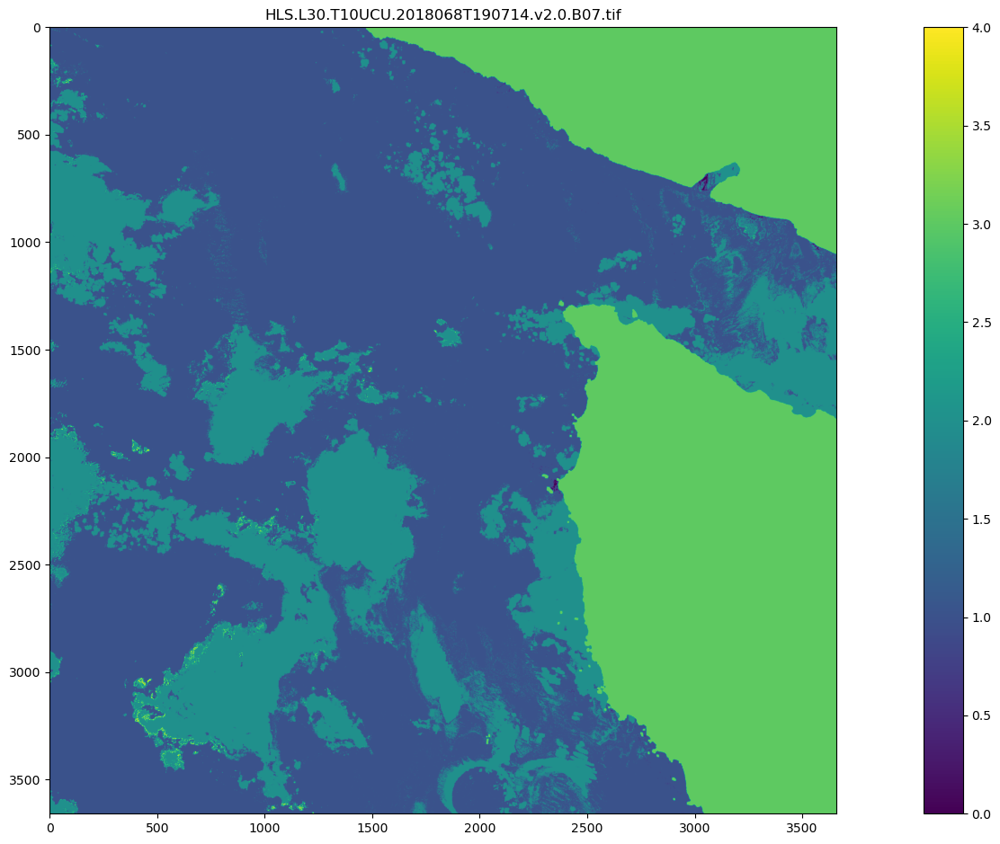

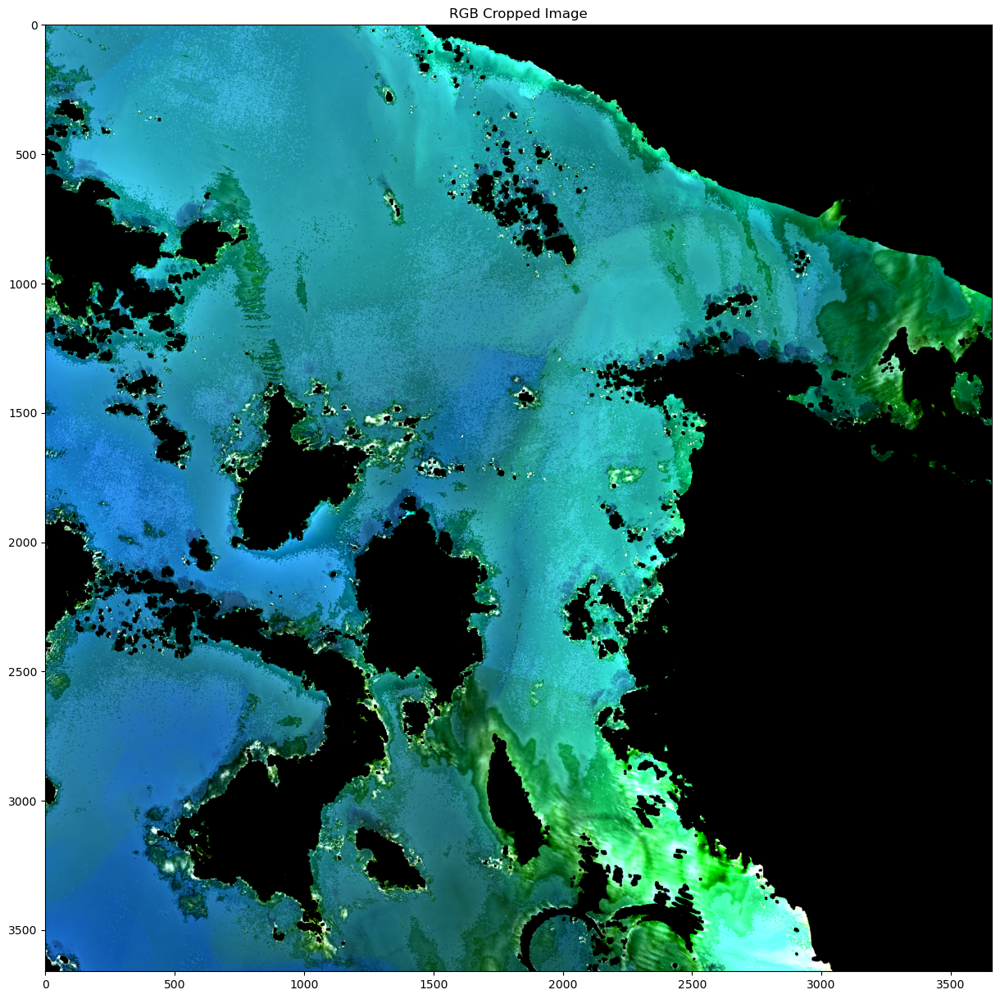

Masking finished. Duration:0.8731164932250977 seconds
MESMA finished. Duration:0.17493033409118652 seconds


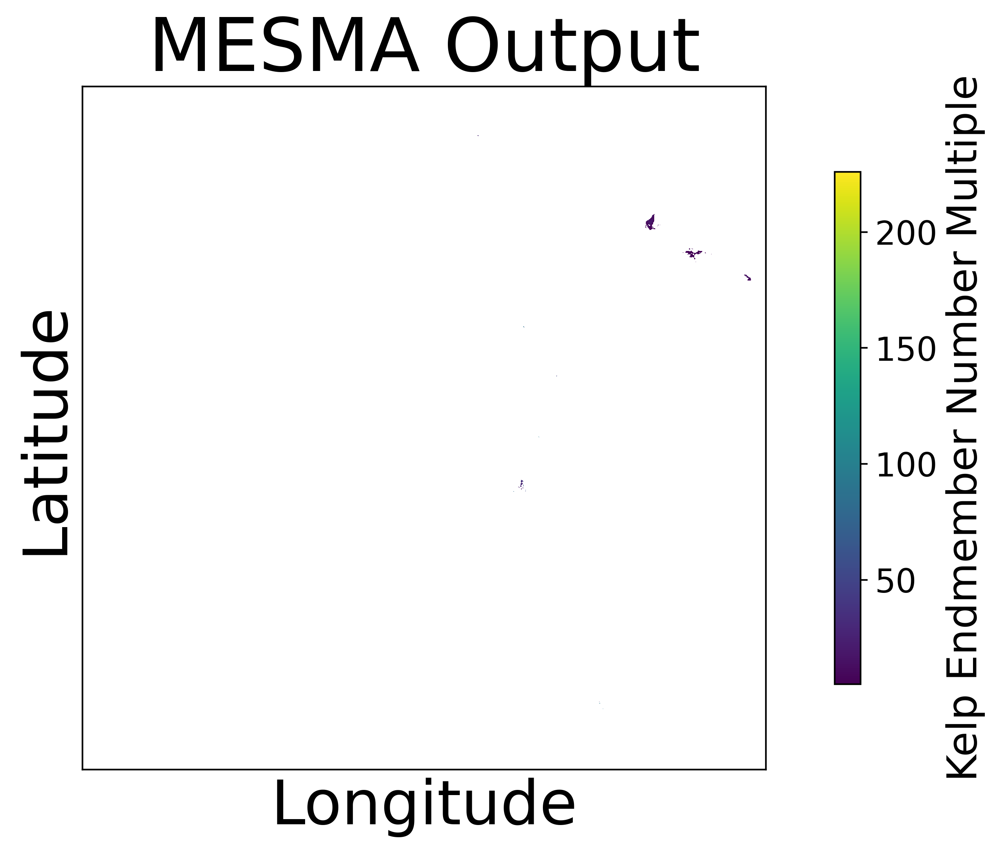

Processed Data Saved. Duration:0.00032901763916015625 seconds
File complete: HLS.L30.T10UCU.2018068T190714.v2.0 | Iteration: 10 | Time: 11.901210308074951
Starting HLS.L30.T10UCU.2018075T191320.v2.0
HLS.L30.T10UCU.2018075T191320.v2.0 Percent cloud covered: 0.3306362134978625
Files Loaded. Duration:1.6152136325836182 seconds
bands normalized for RF. Duration:0.37128710746765137 seconds
RF finished. Duration:2.584777593612671 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1149..2866].


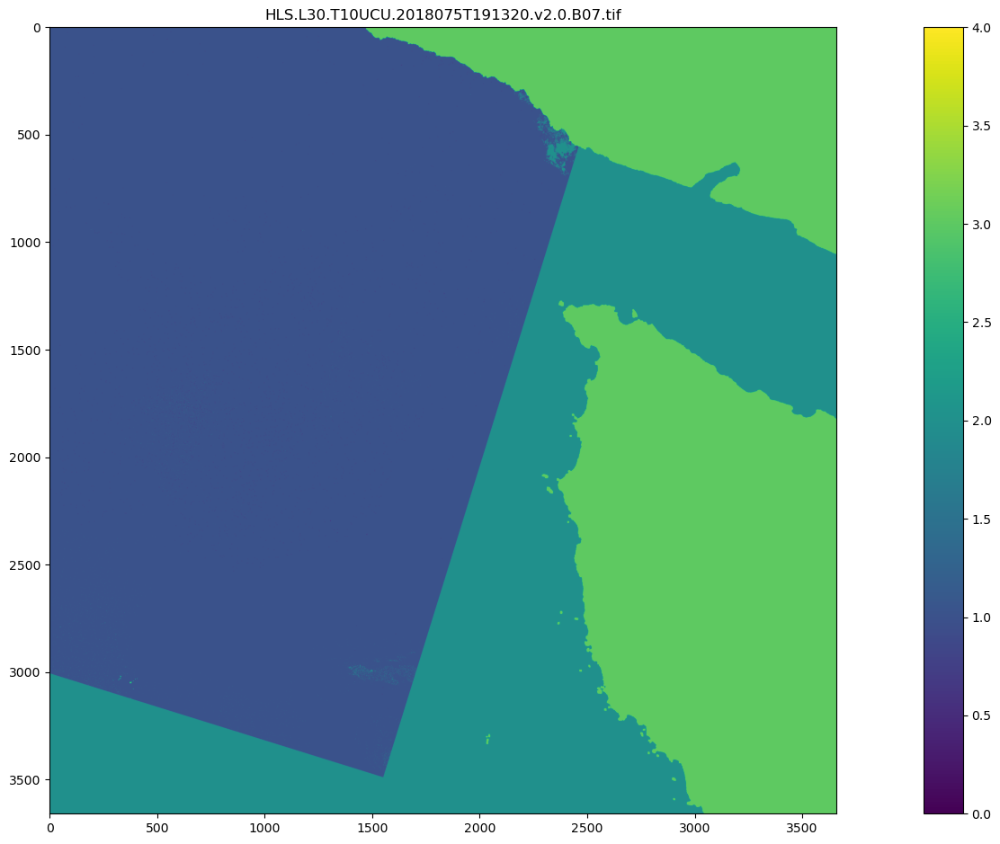

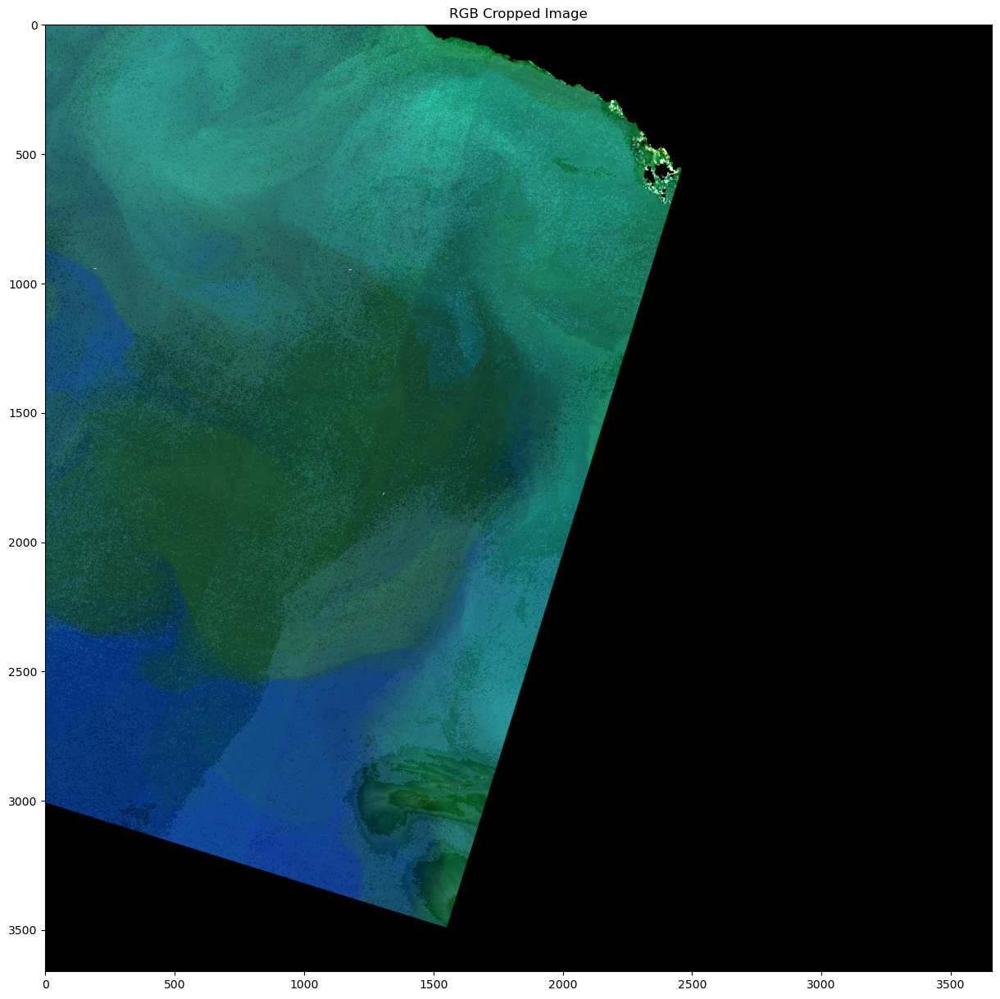

Masking finished. Duration:0.8239097595214844 seconds
MESMA finished. Duration:0.2041938304901123 seconds


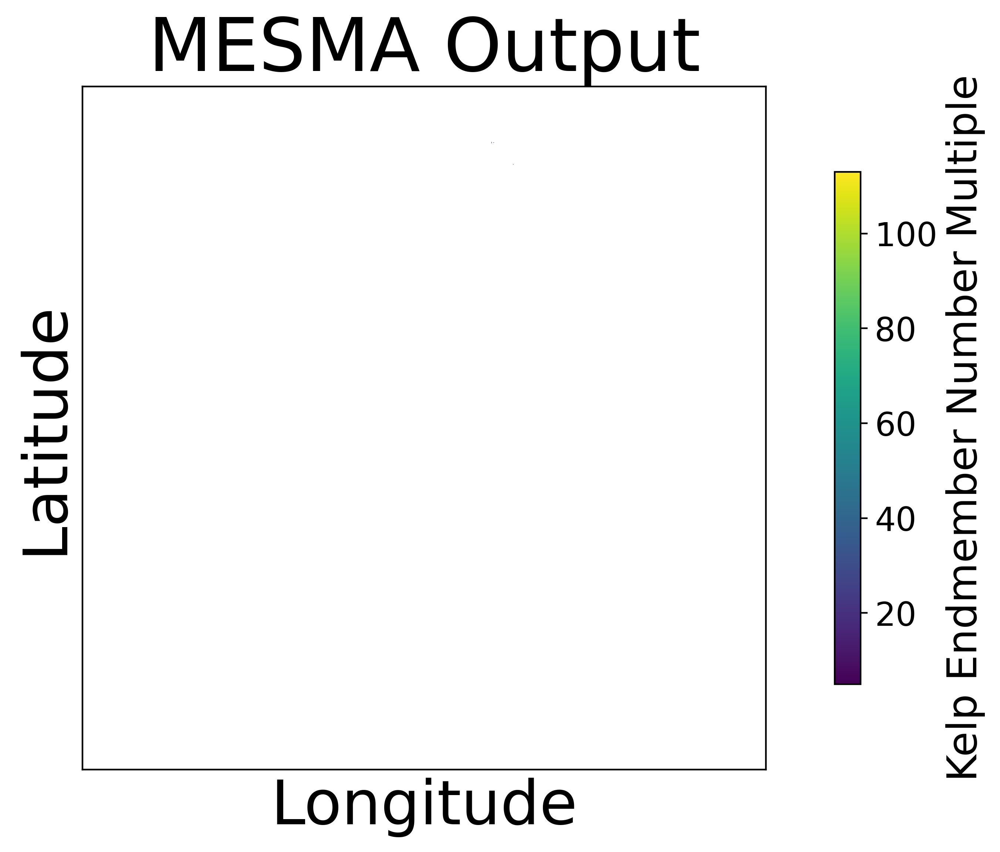

Processed Data Saved. Duration:0.0002753734588623047 seconds
File complete: HLS.L30.T10UCU.2018075T191320.v2.0 | Iteration: 11 | Time: 10.228827476501465
Starting HLS.L30.T10UCU.2018091T191314.v2.0
Starting HLS.L30.T10UCU.2018125T190033.v2.0
Starting HLS.L30.T10UCU.2018196T190647.v2.0
HLS.L30.T10UCU.2018196T190647.v2.0 Percent cloud covered: 0.00020917957579065556
Files Loaded. Duration:2.780158281326294 seconds
bands normalized for RF. Duration:0.2356562614440918 seconds
RF finished. Duration:3.3712472915649414 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1190..2738].


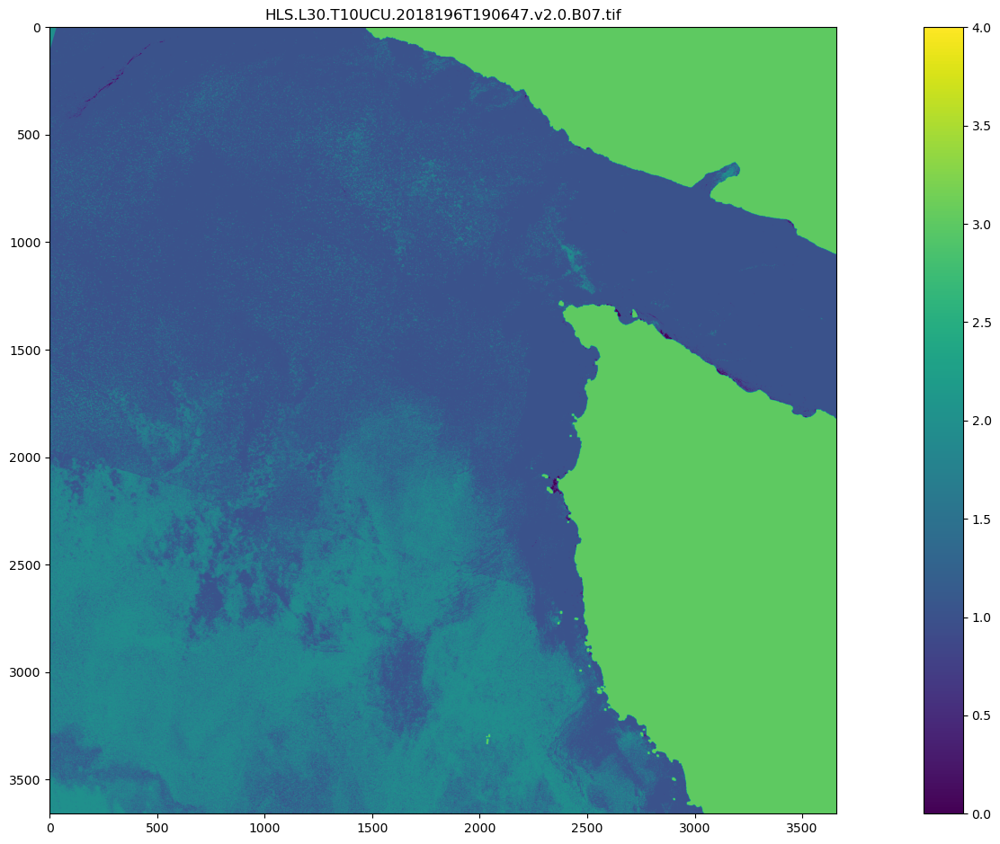

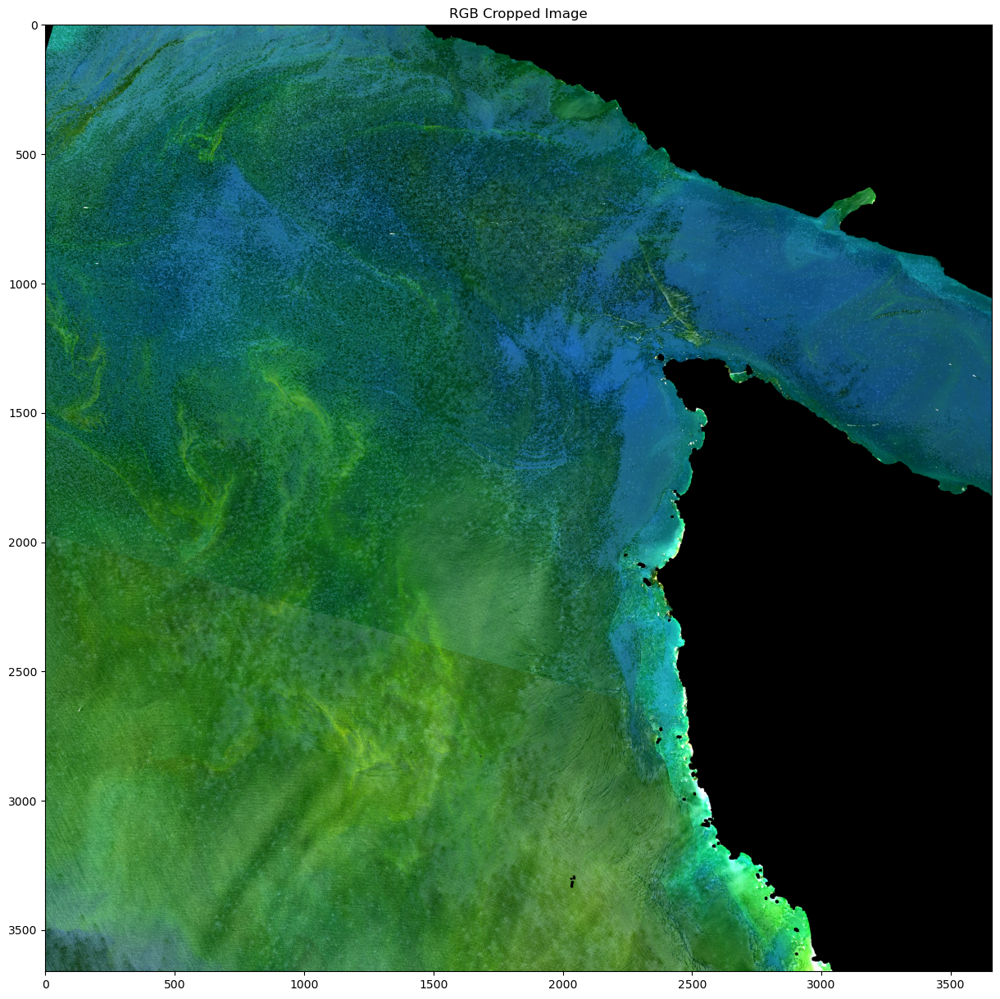

Masking finished. Duration:0.8645598888397217 seconds
MESMA finished. Duration:0.31900596618652344 seconds


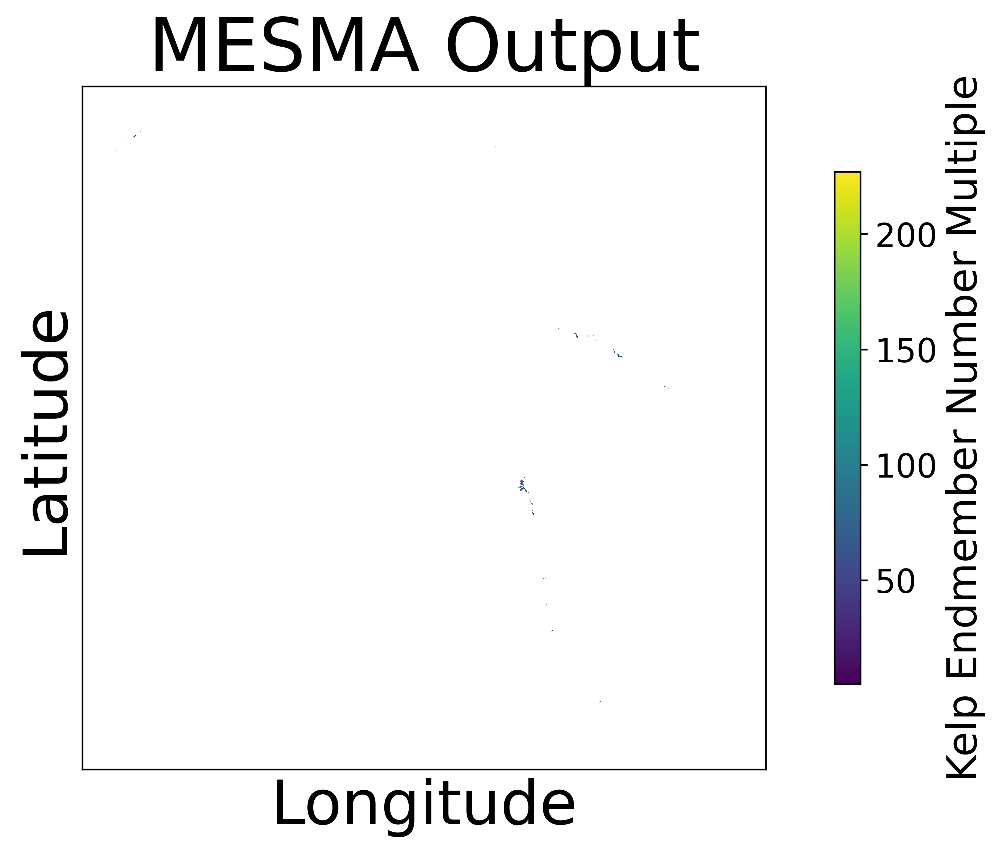

Processed Data Saved. Duration:0.0005218982696533203 seconds
File complete: HLS.L30.T10UCU.2018196T190647.v2.0 | Iteration: 12 | Time: 12.063265085220337
Starting HLS.L30.T10UCU.2018203T191300.v2.0
HLS.L30.T10UCU.2018203T191300.v2.0 Percent cloud covered: 0.3066105168776053
Files Loaded. Duration:2.0071747303009033 seconds
bands normalized for RF. Duration:0.29023122787475586 seconds
RF finished. Duration:2.5689594745635986 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-276..1828].


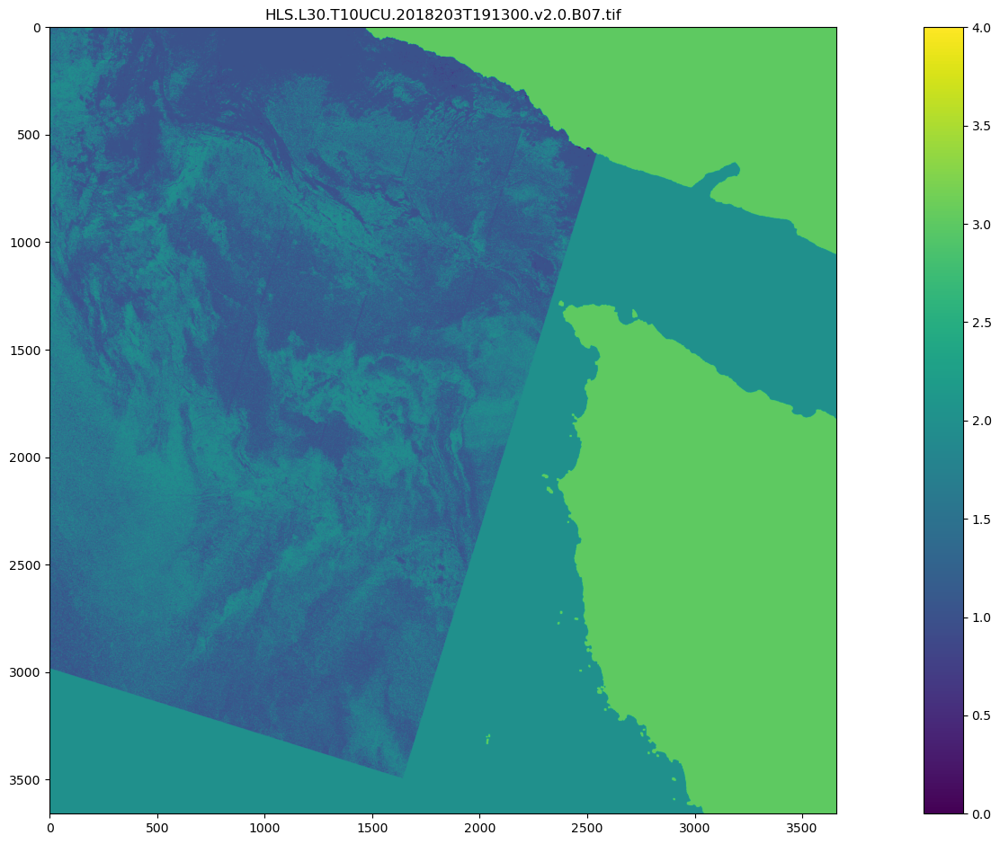

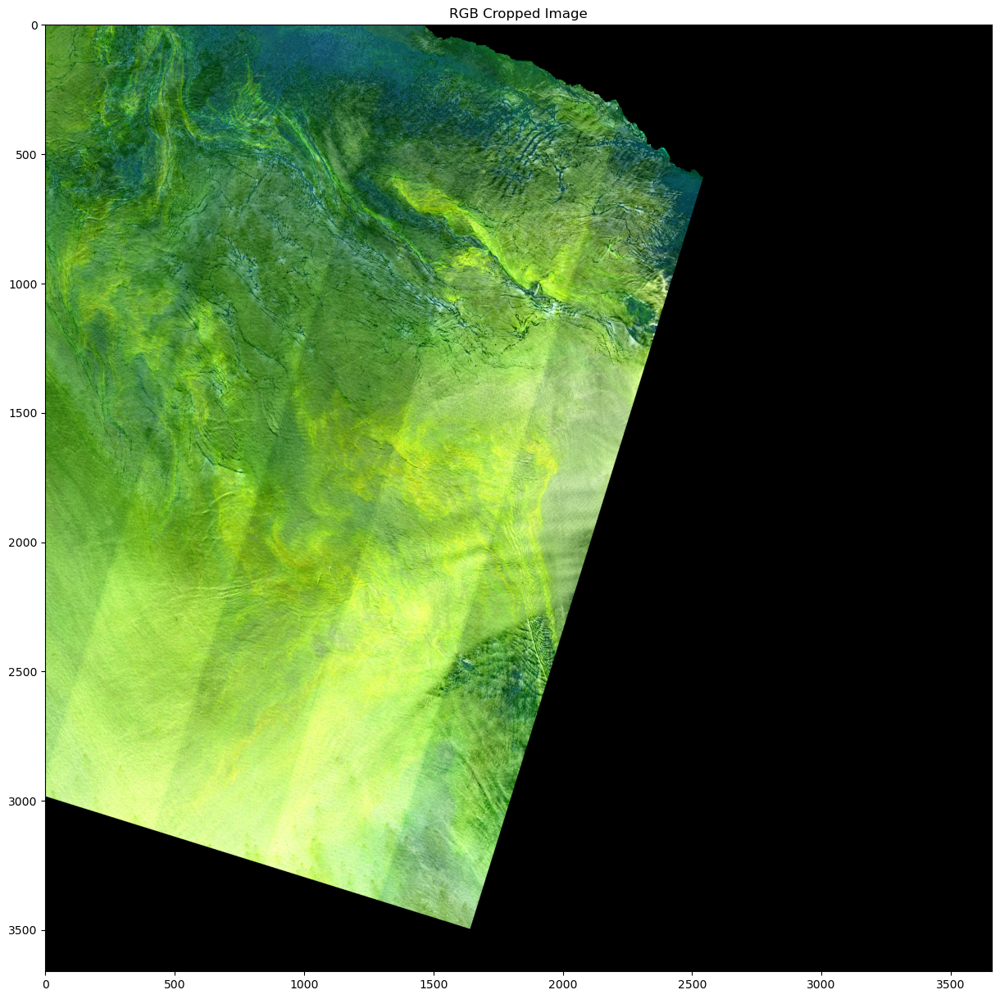

Masking finished. Duration:0.8883523941040039 seconds
MESMA finished. Duration:0.15947389602661133 seconds


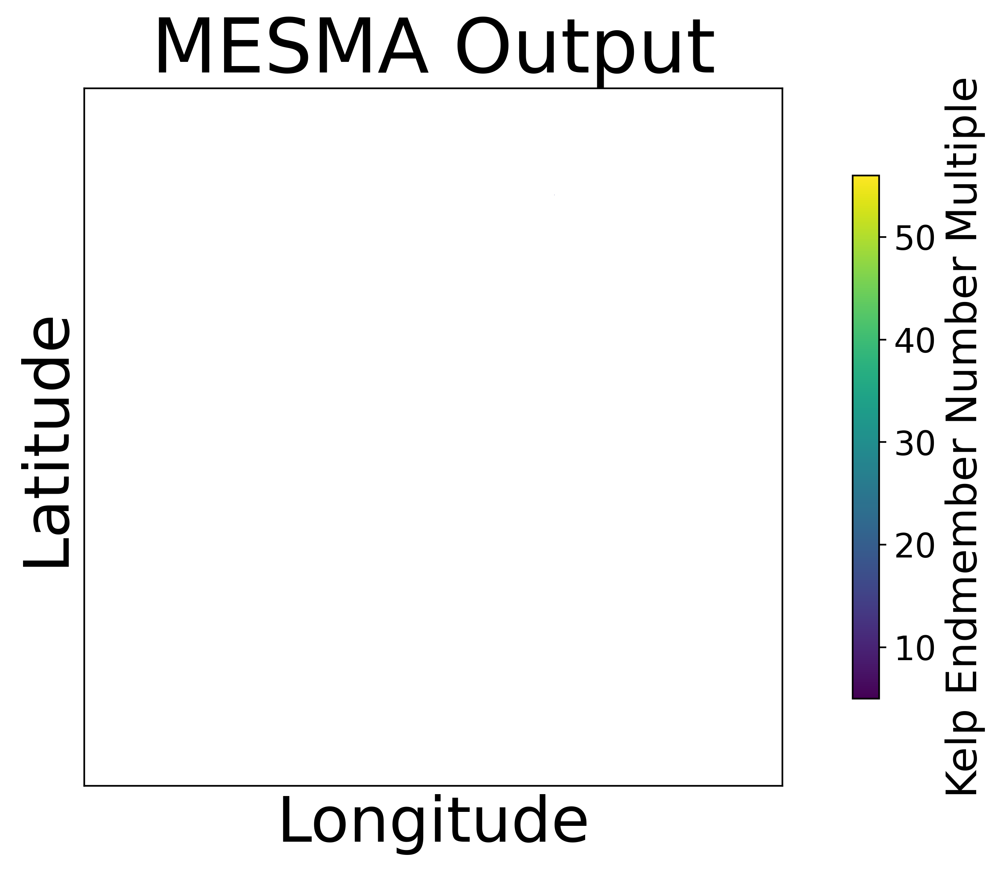

Processed Data Saved. Duration:0.0004374980926513672 seconds
File complete: HLS.L30.T10UCU.2018203T191300.v2.0 | Iteration: 13 | Time: 10.25218939781189
Starting HLS.L30.T10UCU.2018205T190039.v2.0
Starting HLS.L30.T10UCU.2018221T190049.v2.0
Starting HLS.L30.T10UCU.2018244T190710.v2.0
HLS.L30.T10UCU.2018244T190710.v2.0 Percent cloud covered: 0.24693603688637056
Files Loaded. Duration:2.7725725173950195 seconds
bands normalized for RF. Duration:0.3824799060821533 seconds
RF finished. Duration:2.931628942489624 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1416..4113].


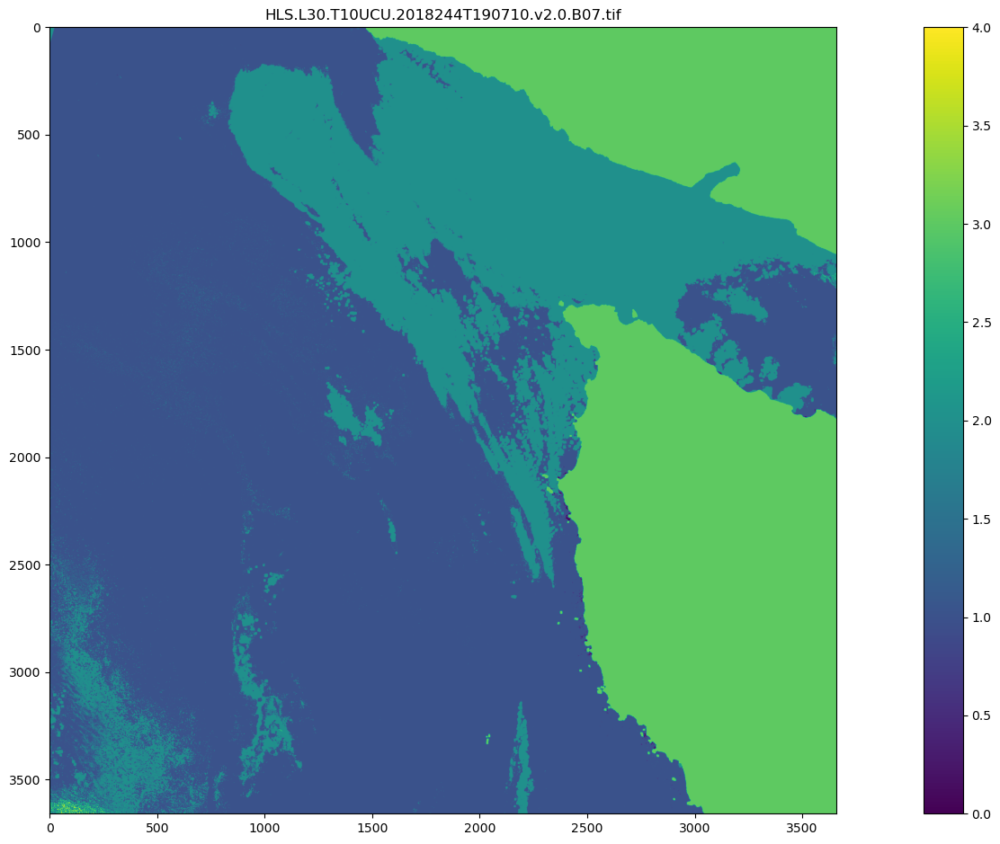

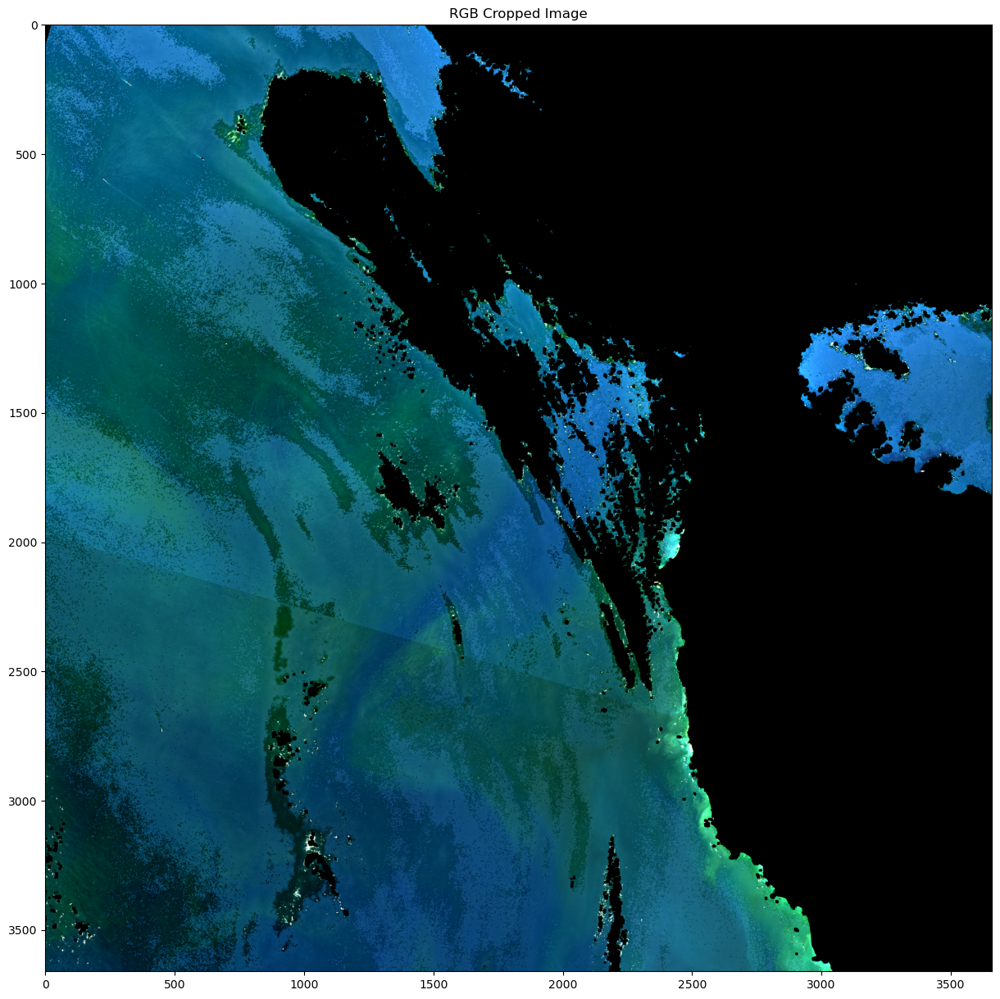

Masking finished. Duration:0.8751988410949707 seconds
MESMA finished. Duration:0.22798585891723633 seconds


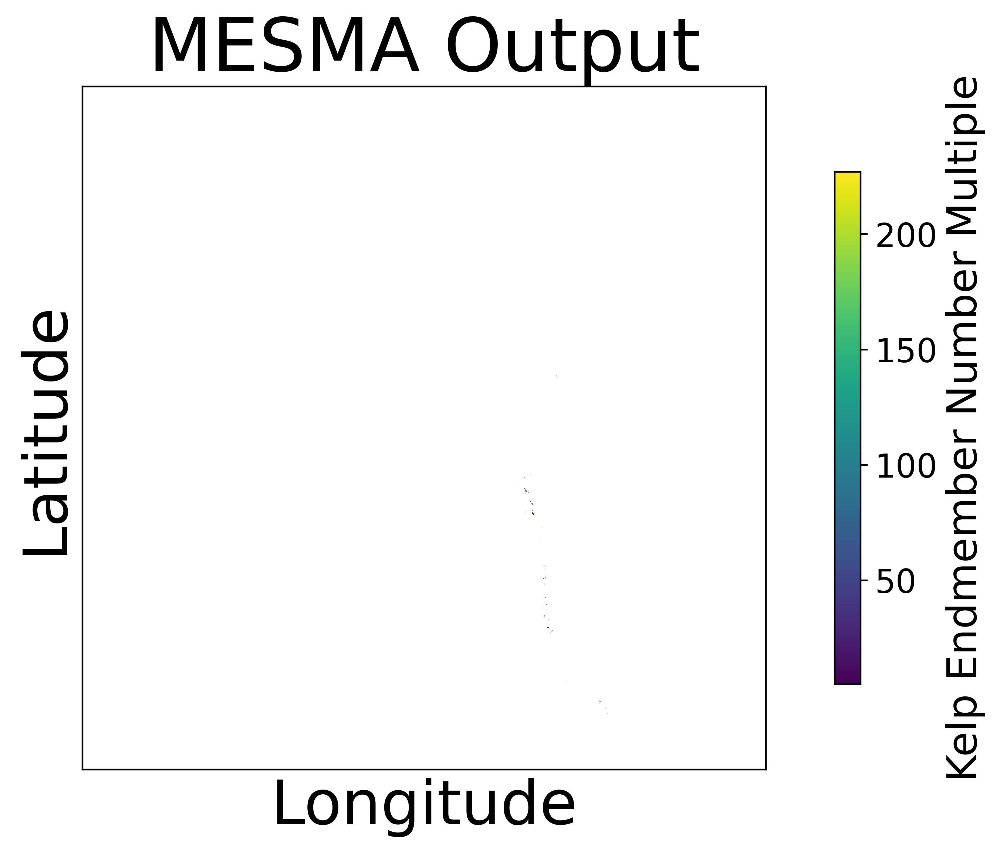

Processed Data Saved. Duration:0.0003941059112548828 seconds
File complete: HLS.L30.T10UCU.2018244T190710.v2.0 | Iteration: 14 | Time: 11.961302042007446
Starting HLS.L30.T10UCU.2018260T190714.v2.0
HLS.L30.T10UCU.2018260T190714.v2.0 Percent cloud covered: 0.0029983746113692766
Files Loaded. Duration:2.839906930923462 seconds
bands normalized for RF. Duration:0.4065206050872803 seconds


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-971..3080].


RF finished. Duration:3.221529006958008 seconds


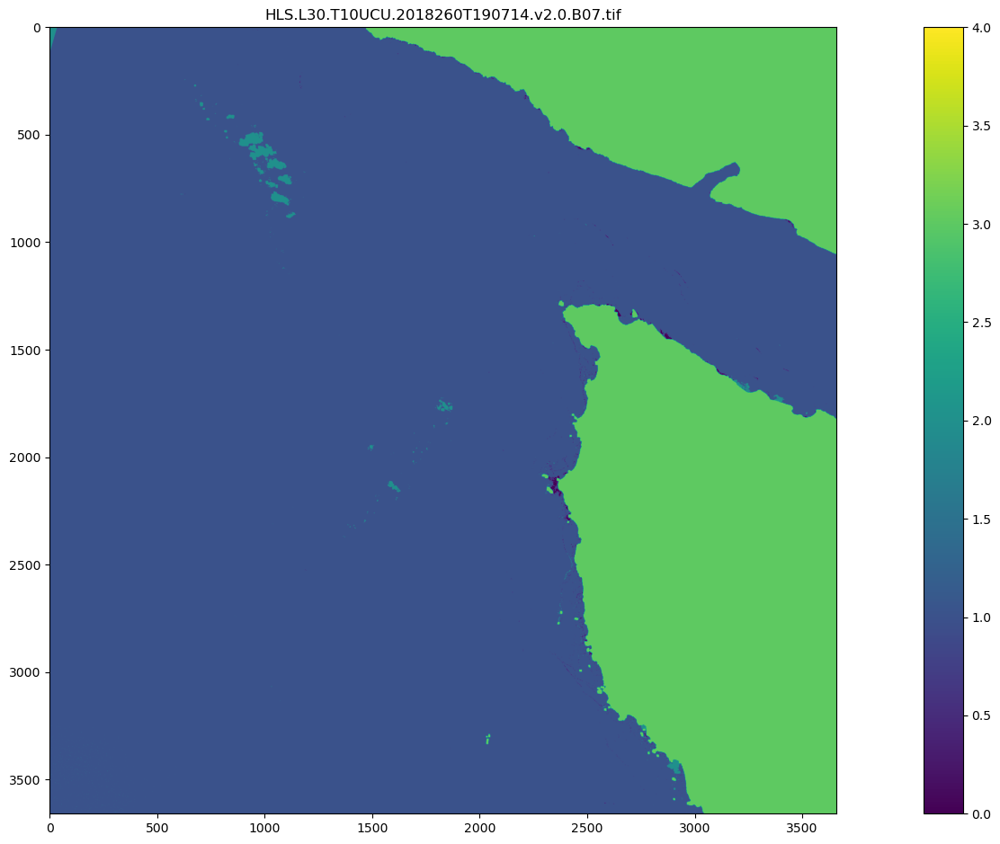

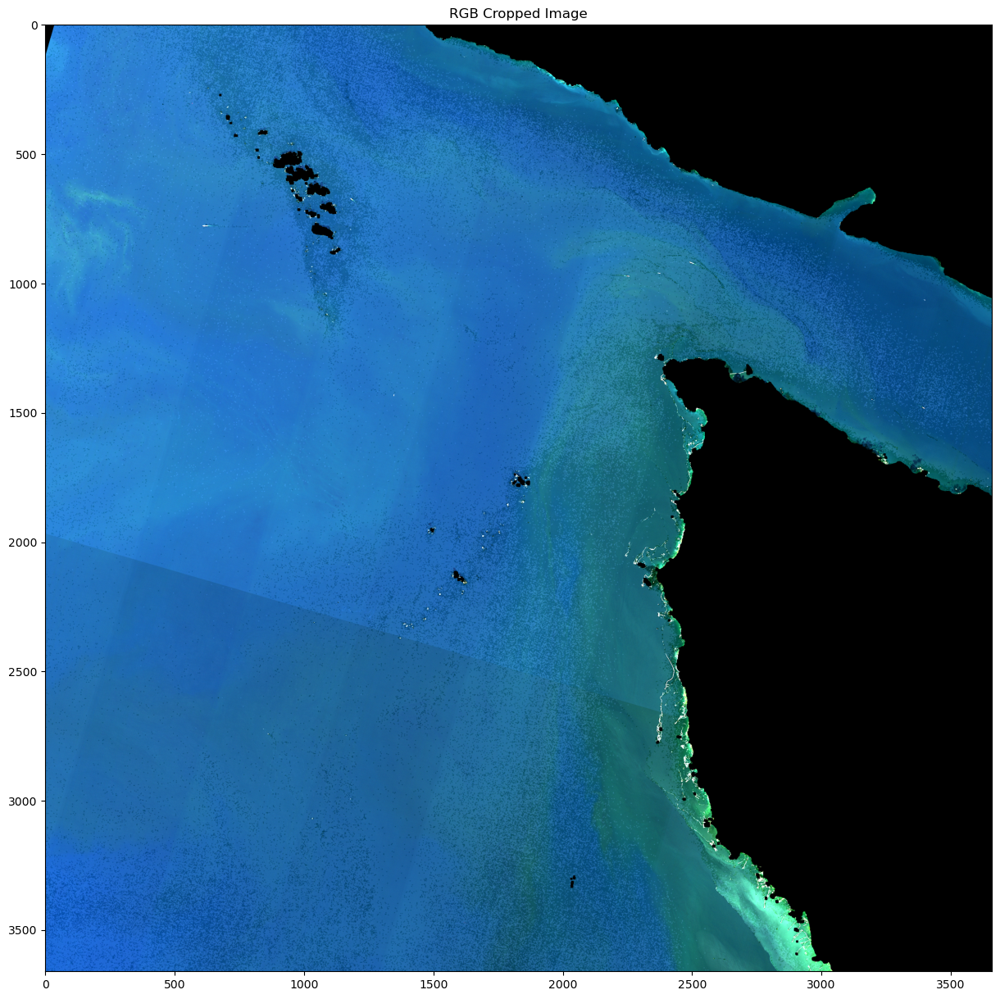

Masking finished. Duration:0.8443603515625 seconds
MESMA finished. Duration:0.27804136276245117 seconds


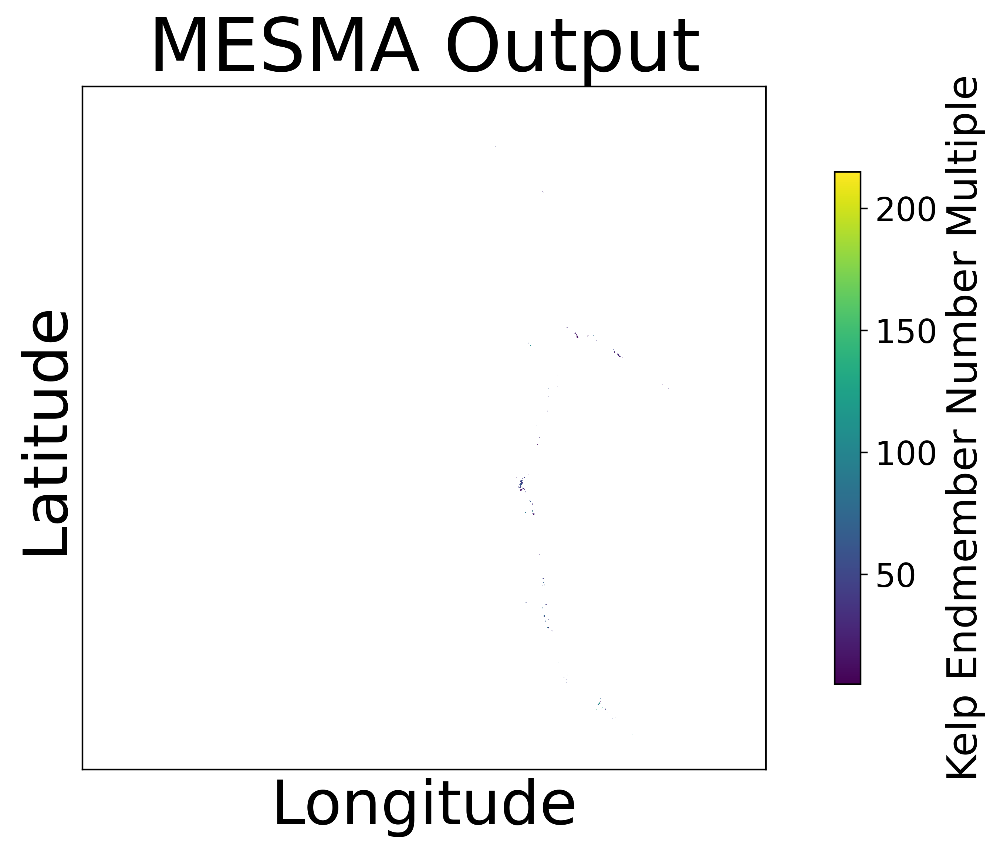

Processed Data Saved. Duration:0.00016188621520996094 seconds
File complete: HLS.L30.T10UCU.2018260T190714.v2.0 | Iteration: 15 | Time: 12.16553807258606
Starting HLS.L30.T10UCU.2018267T191328.v2.0
HLS.L30.T10UCU.2018267T191328.v2.0 Percent cloud covered: 0.4710294831626022
Files Loaded. Duration:1.9141566753387451 seconds
bands normalized for RF. Duration:0.393449068069458 seconds


KeyboardInterrupt: 

In [5]:
if only_pairs:
    all_files  = ft.get_paired_filenames(path)
else:
    all_files = os.listdir(path)
all_files.remove('dem')
for item in all_files:
    if os.path.isdir(os.path.join(path, item)):
        hls_path = os.path.join(path, item)
        granule = item
        break
    else:
        continue

pattern = re.compile(rf'B02.tif$')
files = os.listdir(os.path.join(path, item))
img_files = [f for f in files if re.search(pattern, f)]
geotiff_path = os.path.join(hls_path, img_files[0])

land_mask = kt.create_land_mask(hls_path=geotiff_path, dem_path=dem_path, show_image=False)
del files, img_files, pattern

with open(rf_path, 'rb') as f:
    cu_rf = pickle.load(f)

iterations = 0

if (save_final_data) and not os.path.isdir(save_to_path):
    os.mkdir(save_to_path)


endmember_dict = {}
for item in all_files:
    start_time = time.time()
    #print_memory_usage("Before processing granule")

    if not reclassify and os.path.isfile(os.path.join(save_to_path,tile, f'{item}.tif')):
        #print(f'{item} already processed. Skipping.')
        continue

    print(f'Starting {item}')
    if iterations > num_iterations:
        break

    # Define image path
    if os.path.isdir(os.path.join(path, item)):
        img_path = os.path.join(path, item)
    else:
        print('object is file, continue')
        continue
    
    try:
        sorted_files = kt.filter_and_sort_files(img_path, item)
    except:
        print(f"{item} failed to sort filenames, skipping")
        continue

    if len(sorted_files) != 6:
        print(f'Incomplete file download: {item}')
        continue

    metadata = kt.get_metadata(img_path)
    if metadata is None:
        print(f"{item} missing metadata. Skipping")
        continue
    cloud_land_mask, cloud_but_not_land_mask, percent_cloud_covered = kt.create_qa_mask(land_mask, img_path)
    if percent_cloud_covered >= cloud_cover_threshold:
        #print(f'{item} Percent cloud covered: {percent_cloud_covered}')
        del cloud_land_mask, cloud_but_not_land_mask
        continue
    print(f'{item} Percent cloud covered: {percent_cloud_covered}')
    img_bands = []
    crs = None
    transform = None
    pred_time = time.time()
    try:
        cp_stream = cp.cuda.Stream(non_blocking=True)  # Stream for asynchronous CuPy operations
        with cp_stream:
            with rasterio.Env():  # Ensuring Rasterio is working with the environment
                for file in sorted_files:
                    with rasterio.open(os.path.join(img_path, file)) as src:
                        # Read all bands at once if possible to reduce I/O operations
                        band = cp.asarray(src.read(1))  # Read into a CuPy array
                        img_bands.append(cp.where(cloud_land_mask, 0, band))  # Mask operation
                        
                        # Initialize transform and CRS only once
                        if transform is None:
                            transform = src.transform
                            crs = src.crs

        del cloud_land_mask
    except RasterioIOError as e:
        print(f"Error reading file {file} in granule {item}: {e}")
        continue 

    print(f'Files Loaded. Duration:{time.time() - pred_time} seconds')

    pred_time= time.time()
    img = cp.stack(img_bands, axis=0)
    del img_bands
    n_bands, height, width = img.shape

    img_2D_normalized = kt.normalize_img(img, flatten=False)
    img_data = cudf.DataFrame(img_2D_normalized).astype(np.float32)
     
    del img_2D_normalized
    
    print(f'bands normalized for RF. Duration:{time.time()-pred_time} seconds')
    
    pred_time = time.time()

    reduced_img_data, filtered_indices, original_indices = reduce_cudf_zero(img_data)

    del img_data
    kelp_pred_shrunk= cu_rf.predict(reduced_img_data).astype(cp.float32)

    kelp_pred = revert_cudf_zero(kelp_pred_shrunk.astype(cp.uint8), filtered_indices, original_indices)

    #kelp_pred_cp = cp.asarray(kelp_pred)
    #kelp_pred = cp.where(cp.isnan(kelp_pred_cp), 3, kelp_pred)
    del reduced_img_data, filtered_indices,original_indices
    print(f'RF finished. Duration:{time.time()-pred_time} seconds')


    classified_img = kelp_pred.values_host.reshape(width, height)

    del kelp_pred
    classified_img = cp.where(cloud_but_not_land_mask, 2, cp.asarray(classified_img)) #
    if show_image:
        plt.figure(figsize=(25, 25)) 
        plt.subplot(2, 1, 1)  
        plt.imshow(cp.asnumpy(classified_img))
        plt.colorbar()
        plt.title(file)
        r_nor = img[2, :, :].reshape((height, width))
        g_nor = img[1, :, :].reshape((height, width))
        b_nor = img[0, :, :].reshape((height, width))
        rgb_nor_gpu = cp.stack([r_nor, g_nor, b_nor], axis=-1) 
        rgb_nor = cp.asnumpy(rgb_nor_gpu)
        rgb_cropped = cp.asnumpy(rgb_nor)#[2500:3000,500:1500]#[2700:3400, 600:2000])
        plt.figure(figsize=(15,15))
        plt.imshow(rgb_cropped)
        plt.title("RGB Cropped Image")
        plt.show()
        del rgb_cropped, rgb_nor_gpu, rgb_nor

    mesma_mask_params = [
        100,      # ocean_dilation_size
        6,        # kelp_neighborhood
        3,        # min_kelp_count
        5,       # kelp_dilation_size
        15,       # variance_window_size
        0.95,      # variance_threshold
        True #Variance Mask 
    ]
    pred_time=time.time()
    kelp_mask, ocean_mask = kt.create_mesma_mask(classified_img, img, land_mask, cloud_but_not_land_mask, *mesma_mask_params)
    print(f'Masking finished. Duration:{time.time()-pred_time} seconds')
    img = cp.asnumpy(img)
    classified_img_cpu = cp.asnumpy(classified_img)
    del cloud_but_not_land_mask, classified_img
    ocean_EM = kt.select_ocean_endmembers(ocean_mask=ocean_mask, print_average=False)
    if ocean_EM is None:
        continue

    pred_time = time.time()
    mesma, minVals = kt.run_mesma(kelp_mask, ocean_EM, print_status=False)
    print(f'MESMA finished. Duration:{time.time()-pred_time} seconds')
    if(save_EMs):
        endmember_dict[item] = cp.asnumpy(ocean_EM)
    del ocean_EM, ocean_mask
    minVals = cp.where(cp.isnan(minVals),-999,minVals)
    min_vals = cp.asnumpy(minVals)
    del minVals
    #mesma = cp.where(cp.isnan(mesma), 0, mesma).astype(cp.int16)

    mesma_array = cp.asnumpy(mesma)
    del mesma

    if show_image:
        kelp_img = cp.asnumpy(kelp_mask).astype(np.float32)
        Mes_array_vis = np.where(mesma_array <5 , np.nan, mesma_array)
        #Mes_array_vis = np.where(Mes_array_vis >70 , np.nan, Mes_array_vis)
        kelp_vis = np.where(kelp_img == 0, np.nan, kelp_img)
        plt.figure(figsize=(12, 6), dpi=400)
        #plt.imshow(kelp_img[1], cmap='Greys', alpha=1, extent=extent_latlon, vmax=600) #,2800:3250, 875:1300]
        plt.imshow(Mes_array_vis, alpha=1)#, vmax=80) #[2800:3250, 875:1300][2500:3000,500:1500]
        cbar = plt.colorbar( shrink=.75)
        cbar.ax.tick_params(labelsize=16)  # Set the font size for colorbar ticks
        cbar.set_label('Kelp Endmember Number Multiple', fontsize=20)
        plt.xlabel('Longitude', fontsize=30)
        plt.ylabel('Latitude', fontsize=30)
        #plt.axis('off')
        plt.title("MESMA Output", fontsize=36)
        plt.xticks([],fontsize=16)
        plt.yticks([],fontsize=16)
        plt.show()
        del kelp_mask
    pred_time=time.time()
    if save_final_data:
        num_bands = 3
        data_type = rasterio.int16
        profile = {
            'driver': 'GTiff',
            'width': width,
            'height': height,
            'count': num_bands,  # one band  B02, B03, B04, and B05, classified, mesma (Blue, Green, Red, and NIR).
            'dtype': data_type,  # assuming binary mask, adjust dtype if needed
            'crs': src.crs,
            'transform': src.transform,
            'nodata': 0,  # assuming no data is 0
            'tags': {'TIMESTAMP': metadata['SENSING_TIME'], 'CLOUD_COVERAGE': percent_cloud_covered, 'RF_MODEL': rf_model, 'VIS_LINK': metadata['data_vis_url']}
        }
        if not os.path.isdir(os.path.join(save_to_path, tile)):
            os.mkdir(os.path.join(save_to_path, tile))
        img_path = os.path.join(save_to_path, tile, f'{item}.tif')

        # Write the land mask array to geotiff
        with rasterio.open(img_path, 'w', **profile) as dst:
            dst.write(classified_img_cpu.astype(np.uint8), 1)
            dst.write(mesma_array.astype(data_type), 2)
            dst.write(min_vals.astype(np.float16), 3)
            dst.update_tags(TIMESTAMP=metadata['SENSING_TIME'], CLOUD_COVERAGE=percent_cloud_covered, RF_MODEL=rf_model, VIS_LINK=metadata['data_vis_url'])

    iterations += 1
    print(f'Processed Data Saved. Duration:{time.time()-pred_time} seconds')
    print(f"File complete: {item} | Iteration: {iterations} | Time: {time.time() - start_time}")

    del img, classified_img_cpu, mesma_array, min_vals
    
    if save_EMs and iterations % backup_frequency == 0:
        if os.path.isfile(endmember_path):
            with open(endmember_path, 'rb') as f:
                endmember_log = pickle.load(f)
        else:
            endmember_log = []
        endmember_log.append(endmember_dict)
        
        with open(endmember_path, 'wb') as f:
            pickle.dump(endmember_log, f)
        endmember_dict = {}
        print(f'Endmembers Logged on iteration: {iterations}')


    if sleep and iterations % 30 == 0 and iterations != 0:
        print("Cooling down GPU...")
        time.sleep(240)
        clear_output(wait=True)  
            
    if os.path.isfile(endmember_path):
        with open(endmember_path, 'rb') as f:
            endmember_log = pickle.load(f)
    else:
        endmember_log = []
    endmember_log.append(endmember_dict)

    with open(endmember_path, 'wb') as f:
        pickle.dump(endmember_log, f)
    # print(full_df.shape)
    # print(filtered_indices.shape)
    # print(reduced_df.shape)

In [6]:
if os.path.isfile(endmember_path):
    with open(endmember_path, 'rb') as f:
        endmember_log = pickle.load(f)
else:
    endmember_log = []
endmember_log.append(endmember_dict)

with open(endmember_path, 'wb') as f:
    pickle.dump(endmember_log, f)